In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

In [2]:
# Required plotting setting
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
import matplotlib.pyplot as plt
plt.rc('font', family='serif')
plt.rc('font', serif='Arial')
#plt.style.use('default')
plt.style.use('dark_background')

import seaborn as sns
_font_size = 7.5
sns.set_context("paper", rc={"font.size":_font_size,"axes.titlesize":_font_size+1,"axes.labelsize":_font_size})   

# 2. Load data

In [3]:
#merlin_output_master_folder = r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\human'

merlin_output_master_folder = r'I:\MERFISH_Analysis'
merlin_output_folders = [
    os.path.join(merlin_output_master_folder, r'20221023-hM1_hM1'),
    os.path.join(merlin_output_master_folder, r'20221025-hM1_hM1'),
    os.path.join(merlin_output_master_folder, r'20221026-hM1_hM1'),
]

save_folder = os.path.join(merlin_output_master_folder, 'hM1_hM1-Cx28_summary_new_segmentation')
print(f"save_folder is: {save_folder}")
if not os.path.exists(save_folder):
    os.makedirs(save_folder)
    
figure_folder = os.path.join(save_folder, 'Figures')
if not os.path.exists(figure_folder):
    print(f"Create figure_folder: {figure_folder}")
    os.makedirs(figure_folder)
else:
    print(f"Use figure_folder: {figure_folder}")

sc.settings.figdir = figure_folder

save_folder is: I:\MERFISH_Analysis\hM1_hM1-Cx28_summary_new_segmentation
Use figure_folder: I:\MERFISH_Analysis\hM1_hM1-Cx28_summary_new_segmentation\Figures


In [4]:

raw_filename = os.path.join(save_folder, 'raw_data.h5ad')

overwrite = False

if not os.path.exists(raw_filename) or overwrite:
    print(f"Start merging AnnData")
    adata_list = []
    for _data_folder in merlin_output_folders:

        cell_meta_data_file = os.path.join(_data_folder, 'ExportCellMetadata', 'feature_metadata.csv')
        cell_meta_data = pd.read_csv(cell_meta_data_file)
        counts_file_mer = os.path.join(_data_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
        df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
        for _c in df.columns:
            if 'Blank-' in _c:
                df = df.drop(columns=_c)
        adata = anndata.AnnData(df)
        adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')
        adata.obs['experiment'] = os.path.basename(_data_folder).split('-')[0]
        # load postanalysis h5ad
        #_postanalysis_folder = os.path.join(_data_folder, 'PostAnalysis')
        #_save_filename = os.path.join(os.path.join(_postanalysis_folder, 'filtered_cluster_data.h5ad'))
        #_data = sc.read(_save_filename)
        adata_list.append(adata)
    # merge
    merged_adata = anndata.concat(adata_list, )
    print(f"save adata into file: {raw_filename}")
    merged_adata.write(raw_filename)
else:
    print(f"Directly load from: {raw_filename}")
    merged_adata = sc.read(raw_filename)

Start merging AnnData


C:\Users\puzheng_new\AppData\Local\Temp\2\ipykernel_19740\3915856533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\puzheng_new\AppData\Local\Temp\2\ipykernel_19740\3915856533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\puzheng_new\AppData\Local\Temp\2\ipykernel_19740\3915856533.py:17: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype,

save adata into file: I:\MERFISH_Analysis\hM1_hM1-Cx28_summary_new_segmentation\raw_data.h5ad


# 3. Preprocess and filter the MERFISH data 

In [5]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(merged_adata, percent_top=None, log1p=False, inplace=True)

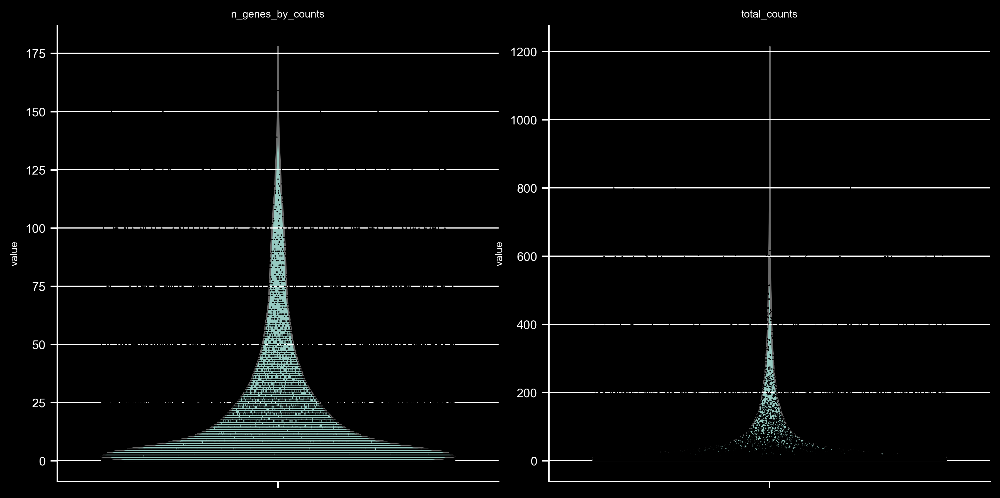

In [6]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True, save='_counts_before_filter.png')

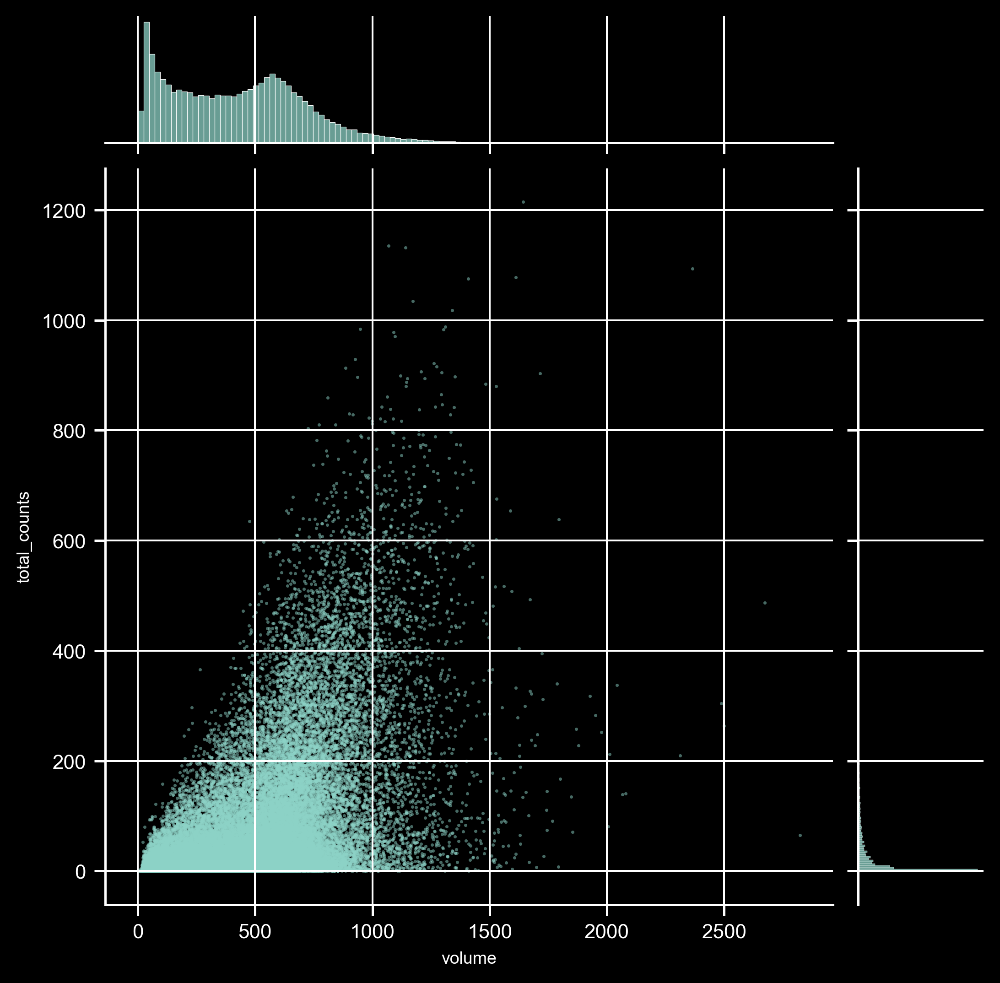

In [7]:
sns.jointplot(data=merged_adata.obs, x='volume', y='total_counts', s=2, linewidth=0, alpha=0.5)

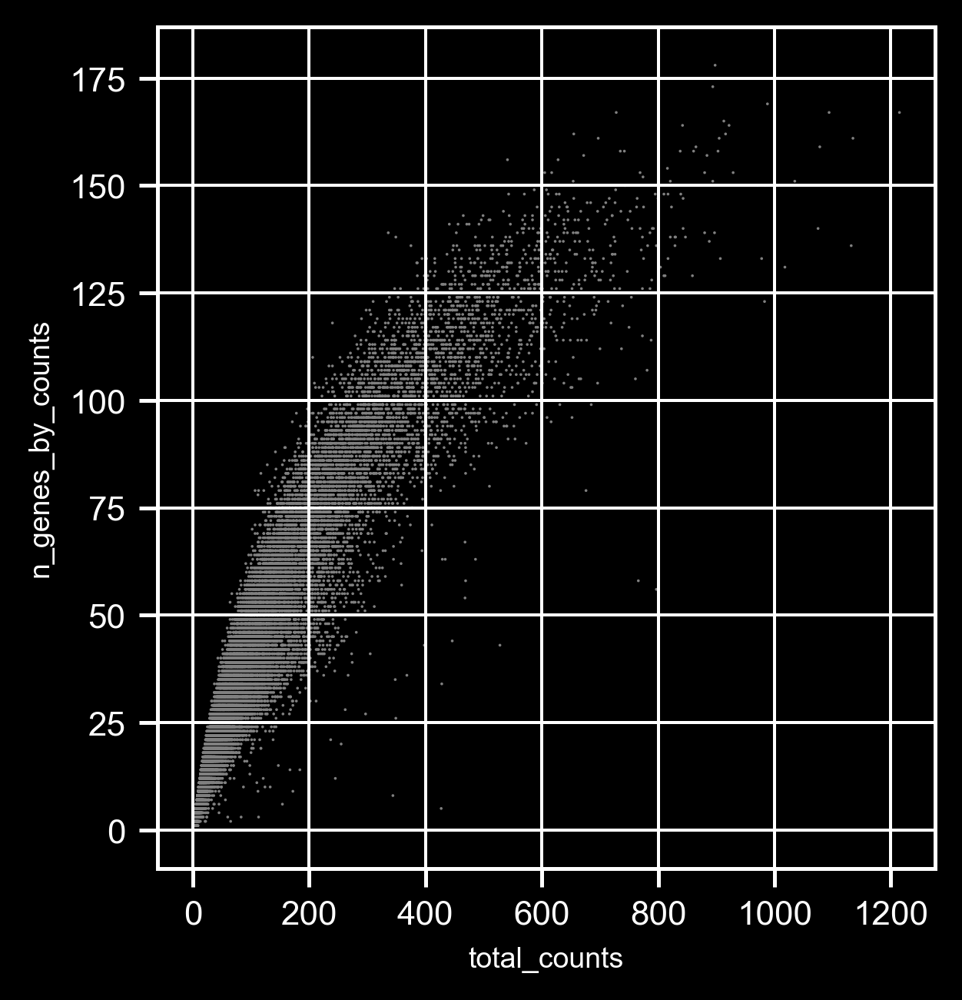

In [8]:
# Plot the distributions of gene counts
sc.pl.scatter(merged_adata, x='total_counts', y='n_genes_by_counts', save='_totalCount_2_numGene.png')

In [9]:
gene_count_threshold = 5
total_count_threshold = 10
volume_threshold = 100
volume_upper_threshold = 5000
# Filtering
merged_adata = merged_adata[merged_adata.obs['n_genes_by_counts'] > gene_count_threshold]
merged_adata = merged_adata[merged_adata.obs['total_counts'] > total_count_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] > volume_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] <= volume_upper_threshold]

print(len(merged_adata))

30562


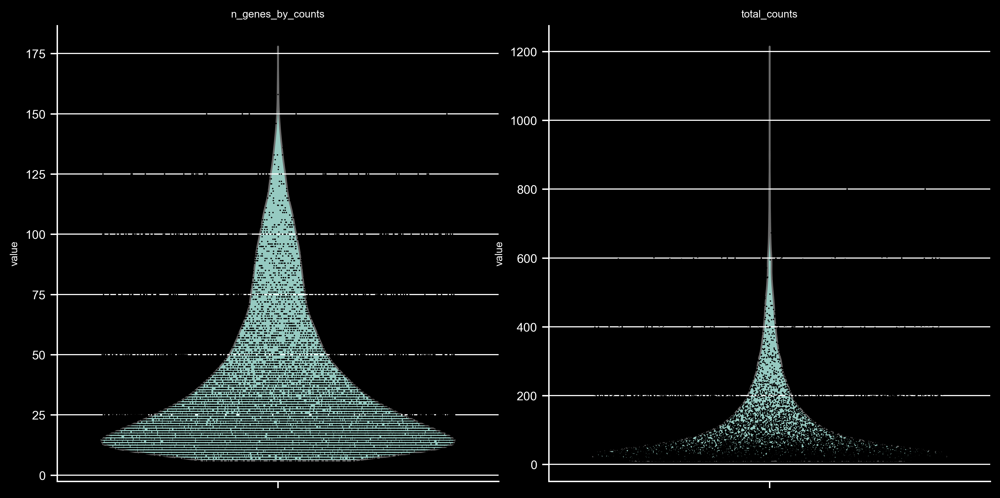

In [10]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True, save='_counts_after_filter.png')

## filter doublet

In [11]:
sc.external.pp.scrublet(merged_adata)

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


Automatically set threshold at doublet score = 0.67
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\external\pp\_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']


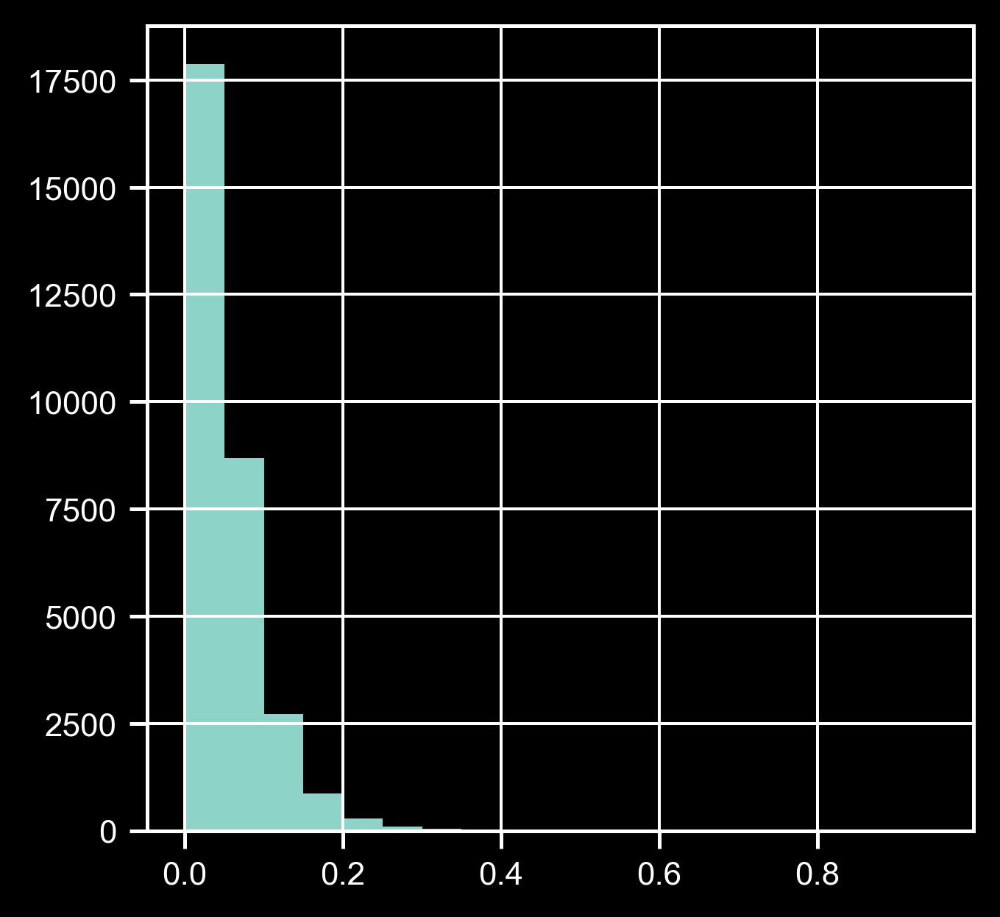

In [12]:
plt.figure()
plt.hist(merged_adata.obs['doublet_score'], bins=np.arange(0,1,0.05))
plt.show()

In [14]:
doublet_score_th = 0.15
np.mean(merged_adata.obs['doublet_score'] > doublet_score_th)

0.042340160984228783

In [15]:
# remove potential doublet

merged_adata = merged_adata[merged_adata.obs['doublet_score'] <= doublet_score_th]
len(merged_adata)

29268

In [16]:
filtered_filename = os.path.join(save_folder, 'filtered_data.h5ad')

overwrite = True

if not os.path.exists(filtered_filename) or overwrite:
    print(f"save adata into file: {filtered_filename}")
    merged_adata.write(filtered_filename)
else:
    print(f"savefile: {filtered_filename} already exists")

save adata into file: I:\MERFISH_Analysis\hM1_hM1-Cx28_summary_new_segmentation\filtered_data.h5ad


In [17]:
# load 
merged_adata = sc.read_h5ad(filtered_filename)

# 4. PCA and UMAP of the MERFISH data (for quick test)

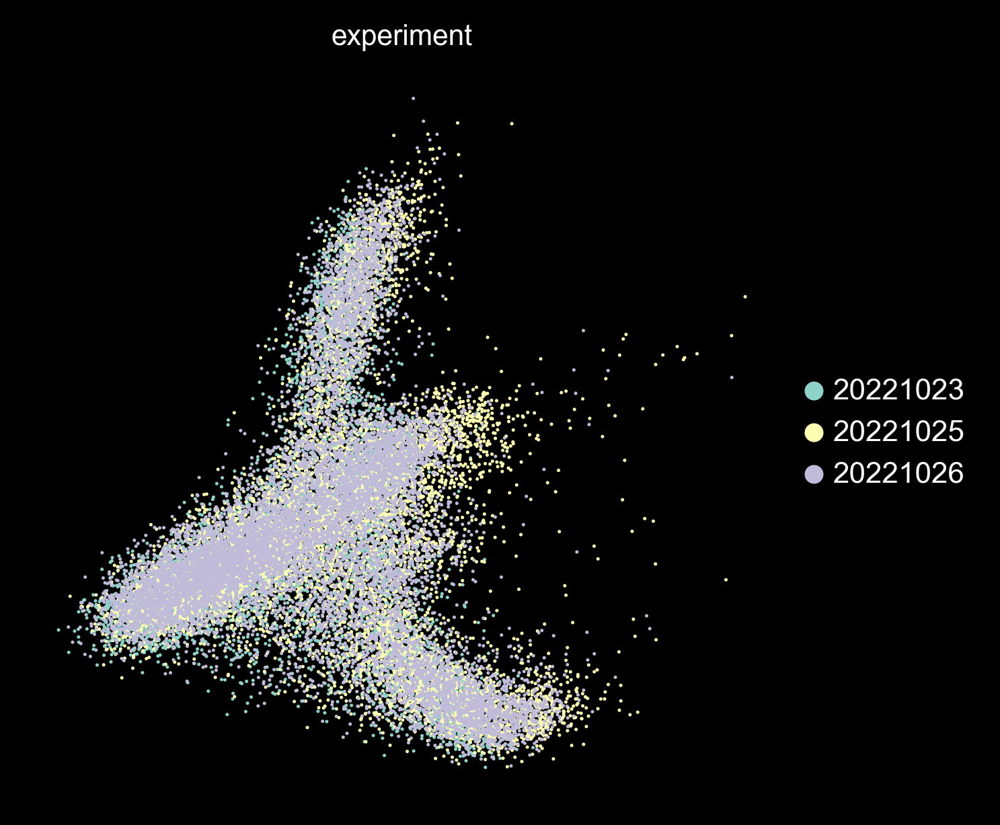

Wall time: 8.43 s


In [18]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(merged_adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(merged_adata)
# Regress out total counts
sc.pp.regress_out(merged_adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(merged_adata, max_value=10)
# Principal component analysis
sc.tl.pca(merged_adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(merged_adata, color='experiment', save='_all_cells.png')

In [19]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=8, n_pcs=30)
# Clustering
sc.tl.leiden(merged_adata, resolution=1)
# Embed with UMAP
sc.tl.umap(merged_adata)

Wall time: 48.5 s


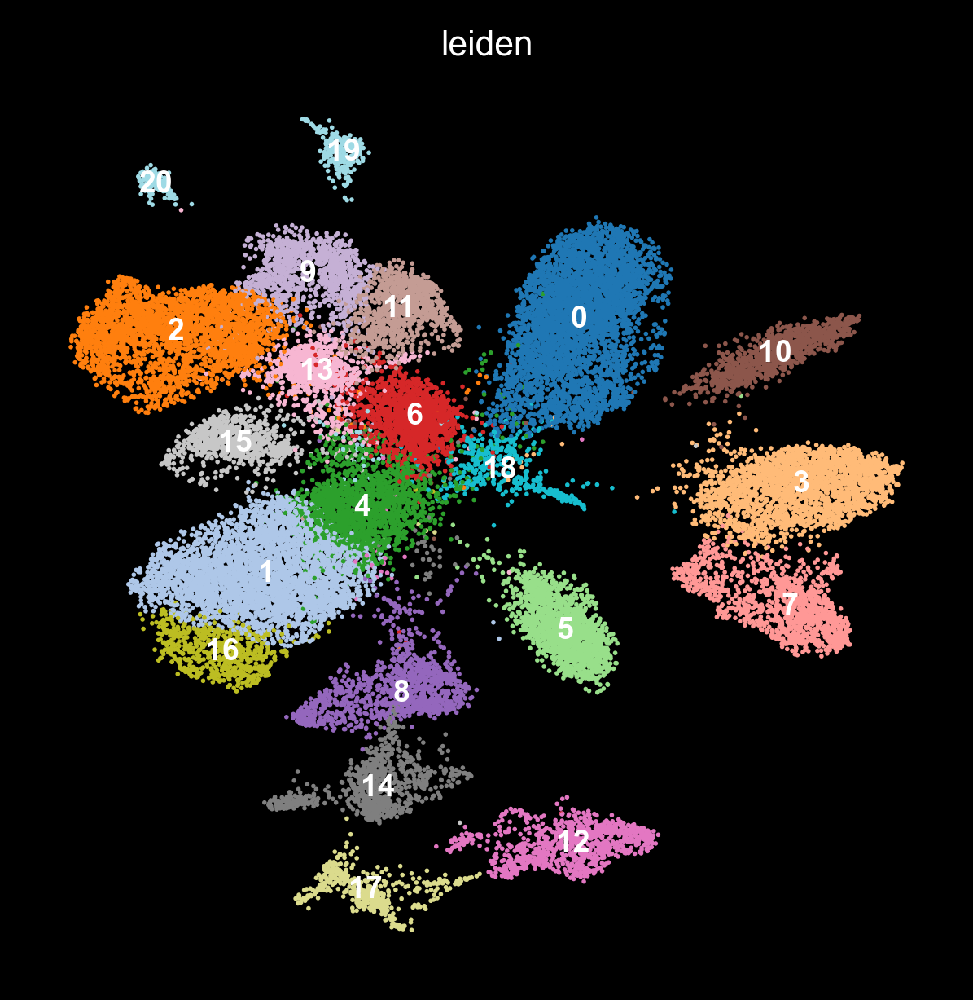

Wall time: 898 ms


In [20]:
%%time
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', 
           legend_loc='on data',
           palette='tab20',
           save='_initial_cluster.png',
           s=5,
           )

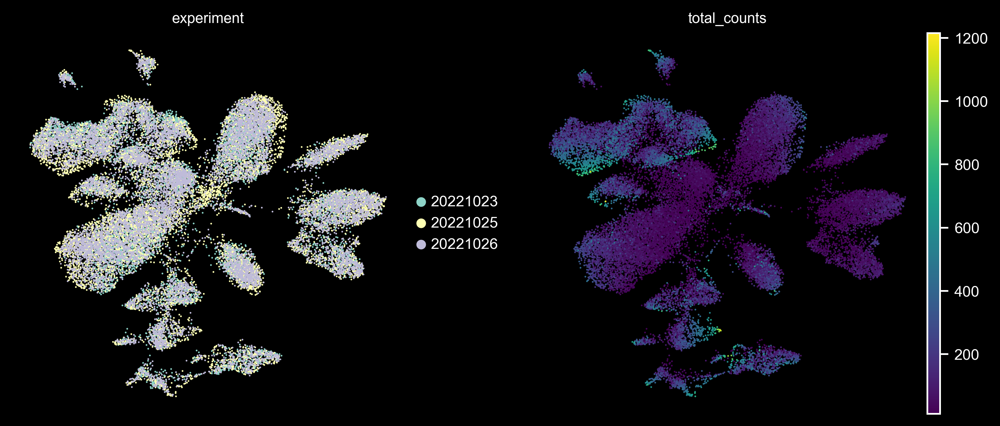

In [21]:
# Plot Umap of different experimental replcates
sc.pl.umap(merged_adata, color=['experiment', 'total_counts'], 
           save='_experiment_counts.png',)

# 5. Check count for each cell for genes of interest

In [22]:
# direcly use previous leiden
merged_adata.obs['leiden_cluster'] = merged_adata.obs.leiden

## T-test to identify marker genes

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2

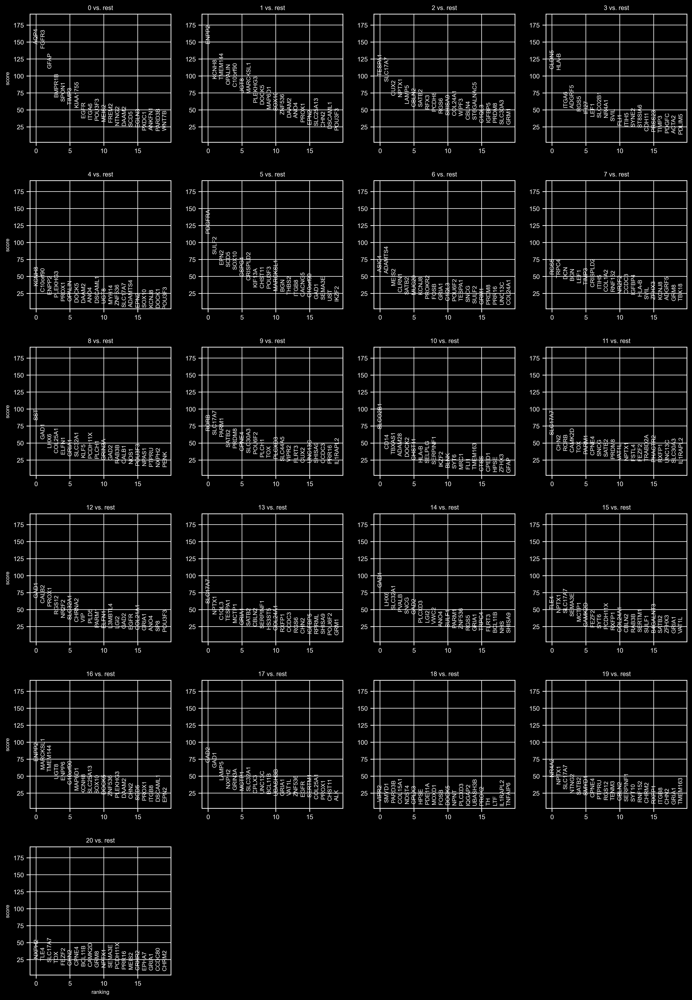

In [23]:
sc.tl.rank_genes_groups(merged_adata, groupby='leiden_cluster', method='t-test')
sc.pl.rank_genes_groups(merged_adata, groupby='leiden_cluster')

In [24]:
gene_ordering = np.array([list(_gnames) for _gnames in merged_adata.uns['rank_genes_groups']['names']])

In [25]:
# assign clusters
clusters = np.sort(np.unique(merged_adata.obs['leiden_cluster']).astype(np.int32))

# Inhibitory
inhibitory_clusters = []
for _i in clusters:
    if np.where(gene_ordering[:,_i]=='GAD1')[0] < 10:
        print(_i, end=', ')
        inhibitory_clusters.append(_i)
# excitatory
print("")
excitatory_clusters = []
for _i in clusters:
    if np.where(gene_ordering[:,_i]=='SLC17A7')[0] < 10:
        print(_i, end=', ')
        excitatory_clusters.append(_i)
nonneuron_clusters = []
for _i in clusters:
    if _i not in inhibitory_clusters and _i not in excitatory_clusters:
        nonneuron_clusters.append(_i)

8, 12, 14, 17, 
2, 9, 11, 13, 15, 19, 20, 

In [26]:
n_nonneu = 0
for _cls in merged_adata.obs['leiden_cluster']:
    if int(_cls) in nonneuron_clusters:
        n_nonneu += 1

print(n_nonneu / len(merged_adata.obs))
        

0.6367022003553369


In [27]:
n_gluta = 0
for _cls in merged_adata.obs['leiden_cluster']:
    if int(_cls) in excitatory_clusters:
        n_gluta += 1

print(n_gluta / len(merged_adata.obs))
        

0.24589995899959


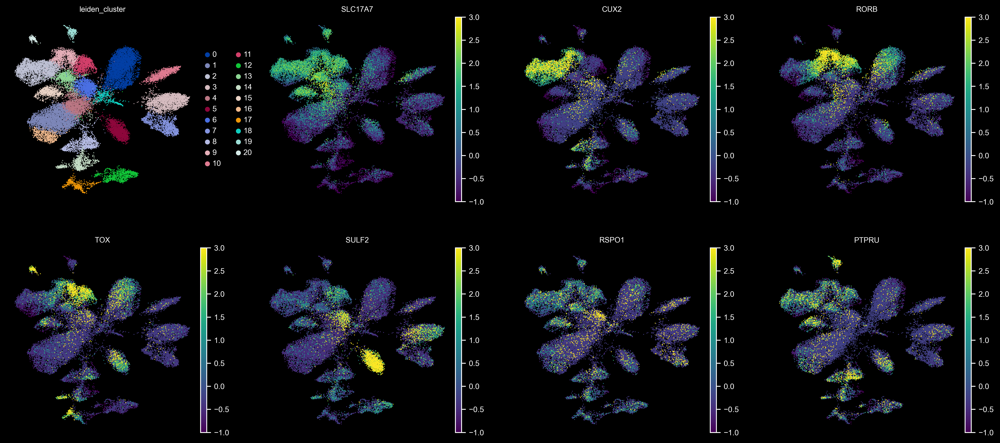

In [28]:
sc.pl.umap(merged_adata, color=['leiden_cluster', 'SLC17A7','CUX2','RORB', 'TOX', 'SULF2', 'RSPO1','PTPRU'],
           vmin=-1, vmax=3, save='_excitatory_gene.png')

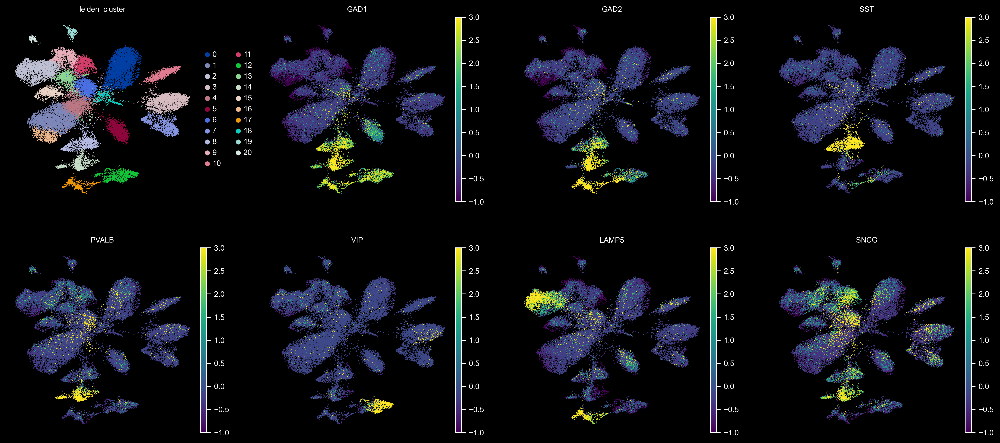

In [29]:
sc.pl.umap(merged_adata, color=['leiden_cluster', 'GAD1','GAD2','SST','PVALB','VIP','LAMP5','SNCG'],
           vmin=-1, vmax=3, save='_inhibitory_gene.png')

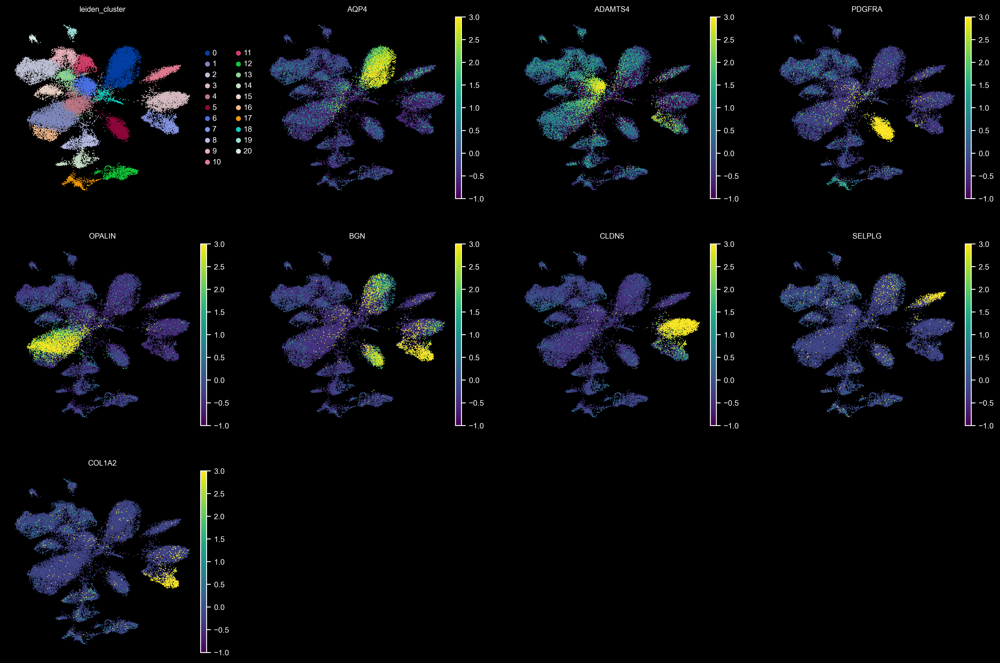

In [30]:
sc.pl.umap(merged_adata, color=['leiden_cluster', 'AQP4', 'ADAMTS4', 'PDGFRA', 'OPALIN', 'BGN', 'CLDN5', 'SELPLG','COL1A2'],
           vmin=-1, vmax=3, save='_nonneuron_gene.png')

In [31]:
experiments = list(np.unique(merged_adata.obs['experiment']))
print(experiments)

['20221023', '20221025', '20221026']


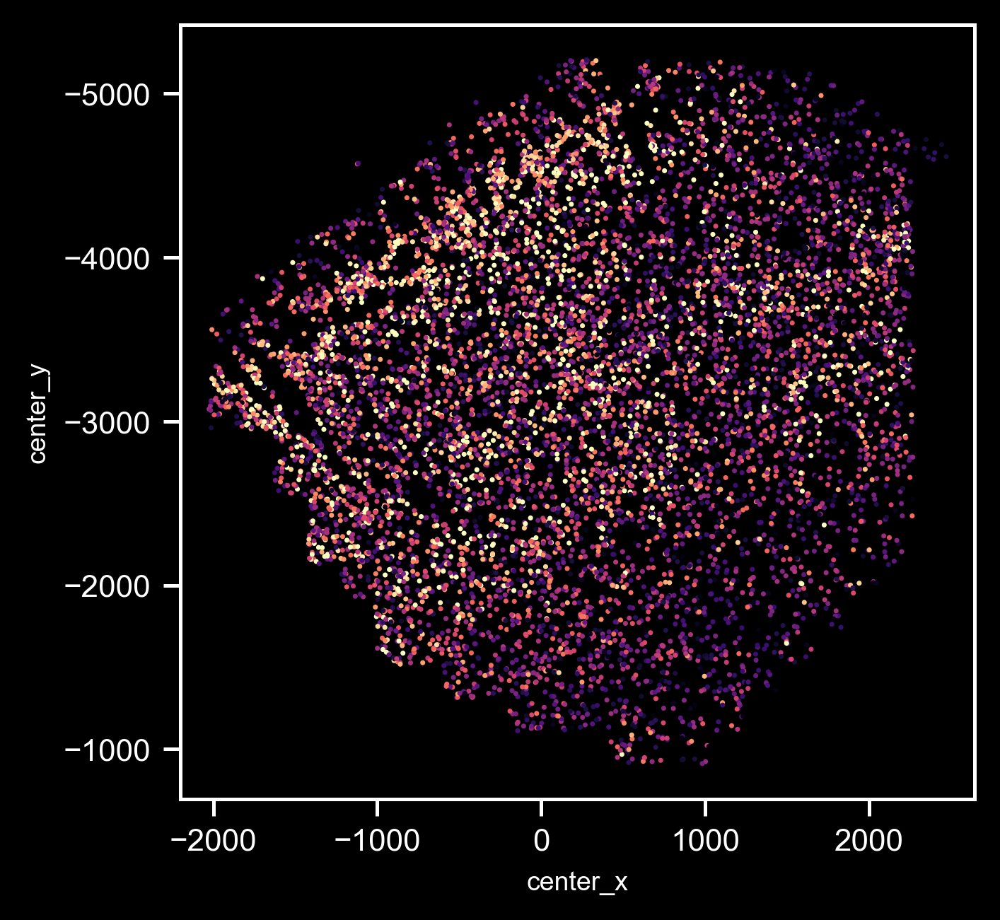

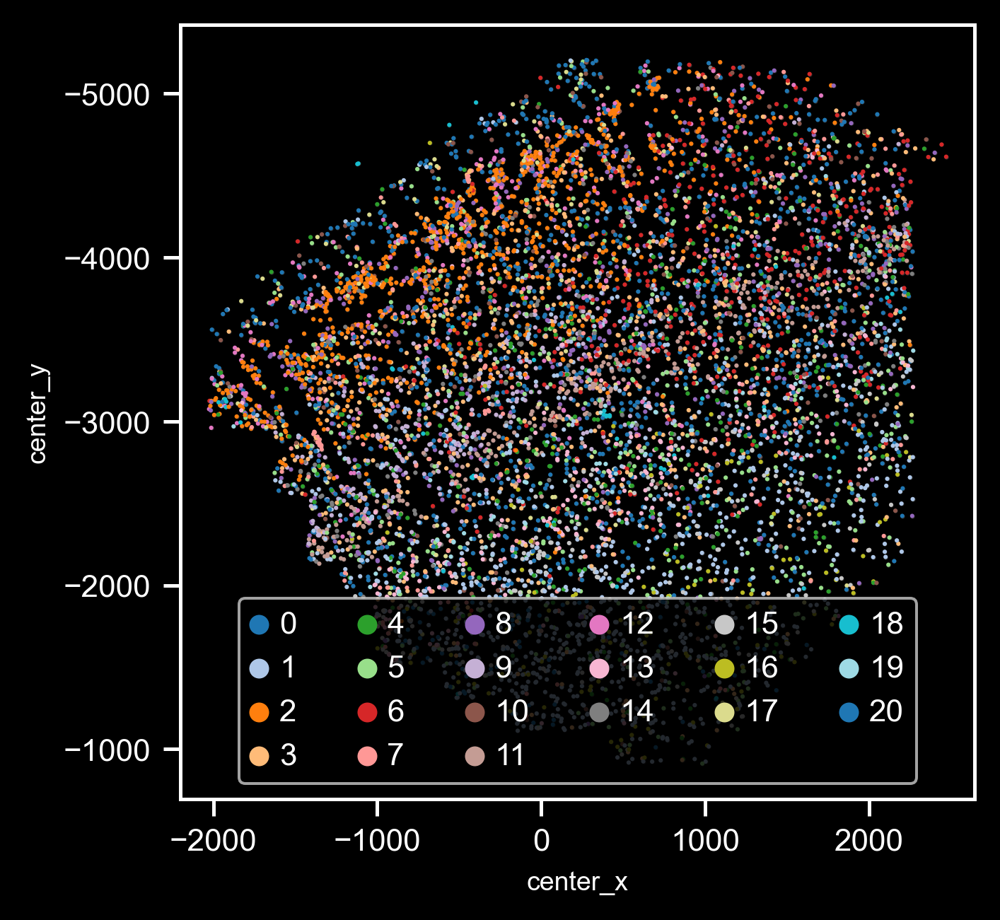

In [32]:
# visualzie the spatial dist for clusters
#import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
sel_experiment_id = 0
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]
#plt.style.use('dark_background')
ax = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                     hue='total_counts', hue_norm=LogNorm(vmin=10,vmax=200), 
                     palette='magma',
                     s=2, linewidth=0,
                     legend=False, )
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
#ax.legend(hs,ls, ncol=8, loc=8)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial-total_counts_{experiments[sel_experiment_id]}.png'), 
            transparent=True)
plt.show()

# visualzie the spatial dist for clusters
sel_clusters = np.unique(sel_obs['leiden_cluster'])

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if _cls in sel_clusters]
ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden', s=1.5, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8)

plt.savefig(os.path.join(figure_folder, f'spatial-all_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


## 6.1 plot different subtypes

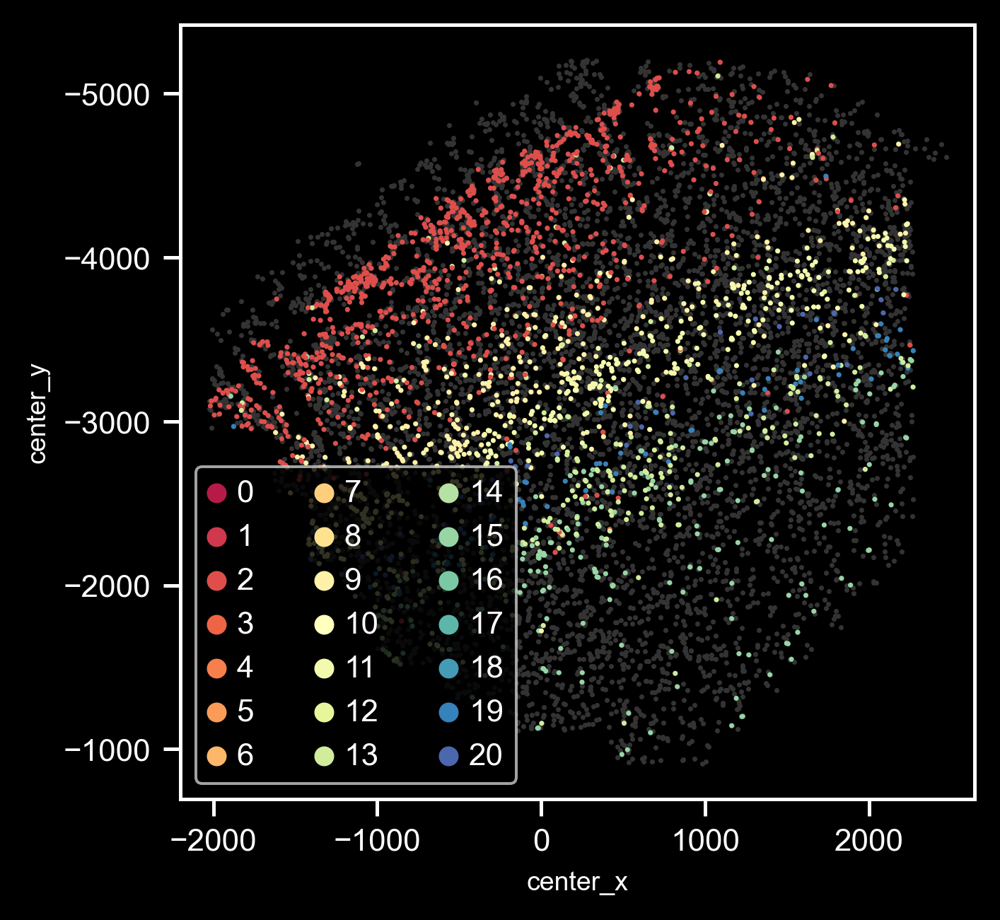

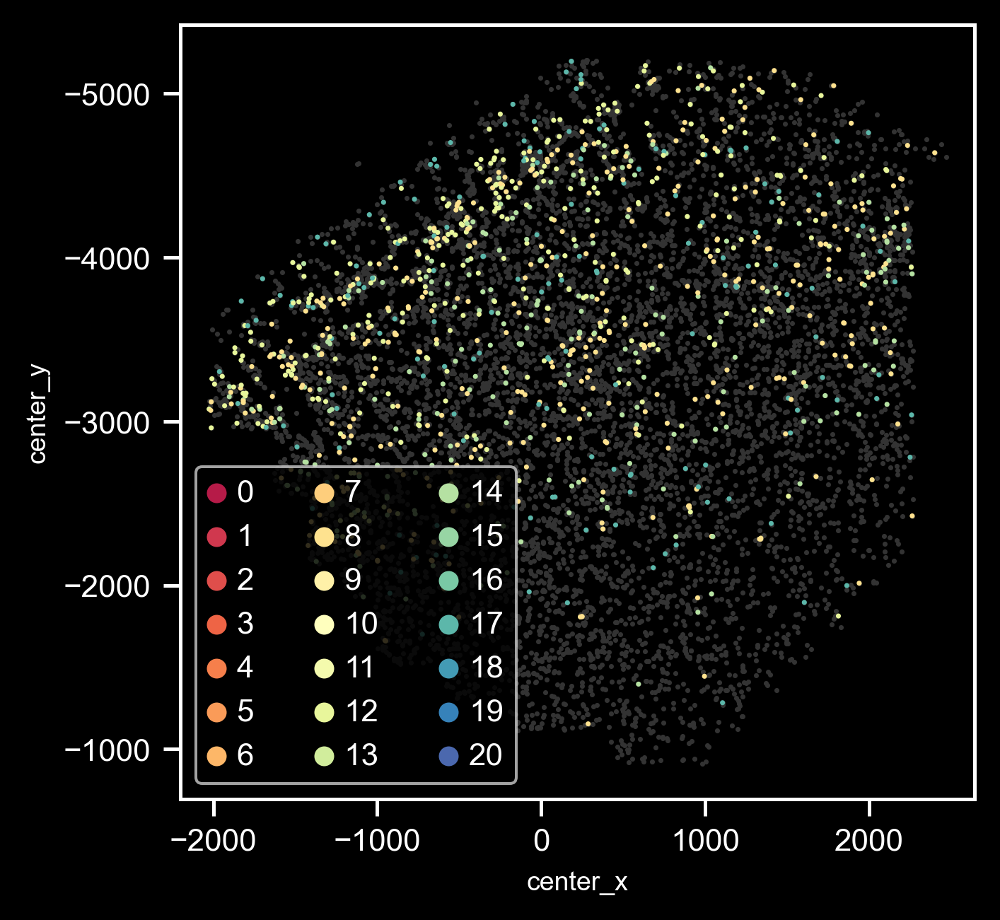

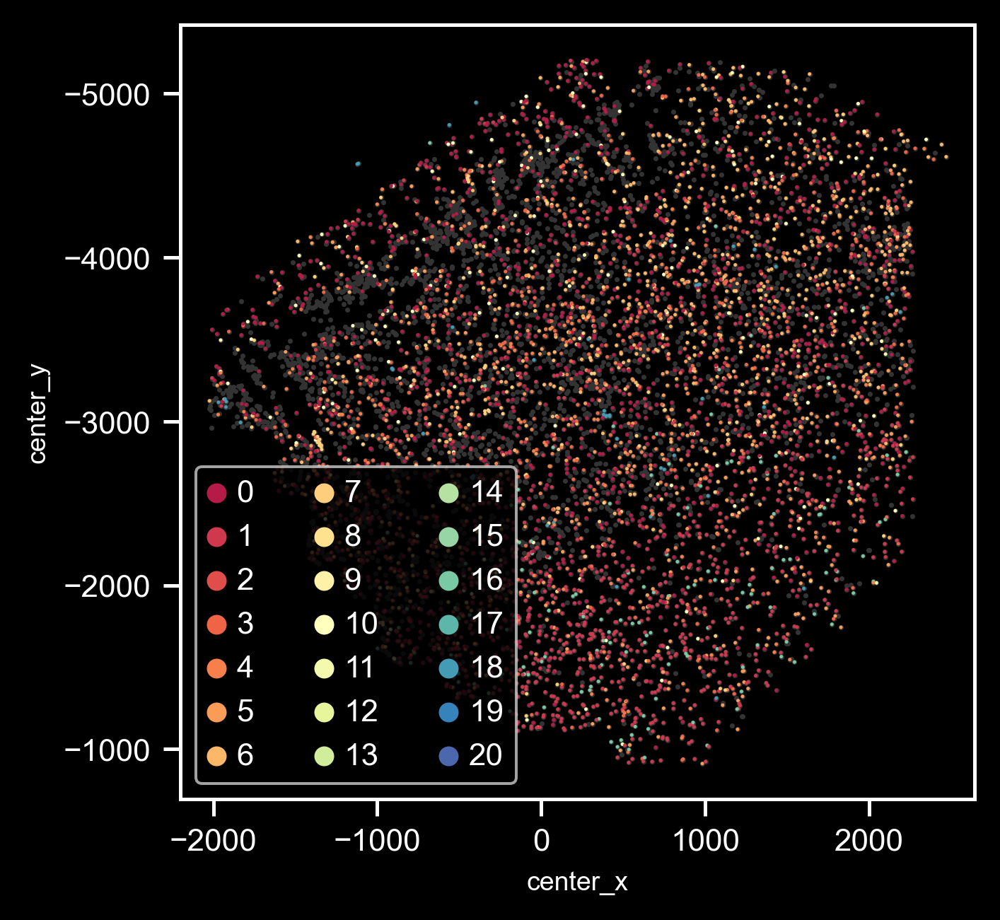

In [33]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]


_current_background = np.array( ax.get_facecolor() )
ref_spot_color = np.abs(_current_background[:3] - 0.2)
ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=ref_spot_color, s=2, legend=True, linewidth=0)
ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)


ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=ref_spot_color, s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=ref_spot_color, s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

In [34]:
sel_experiment_id = 1
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]

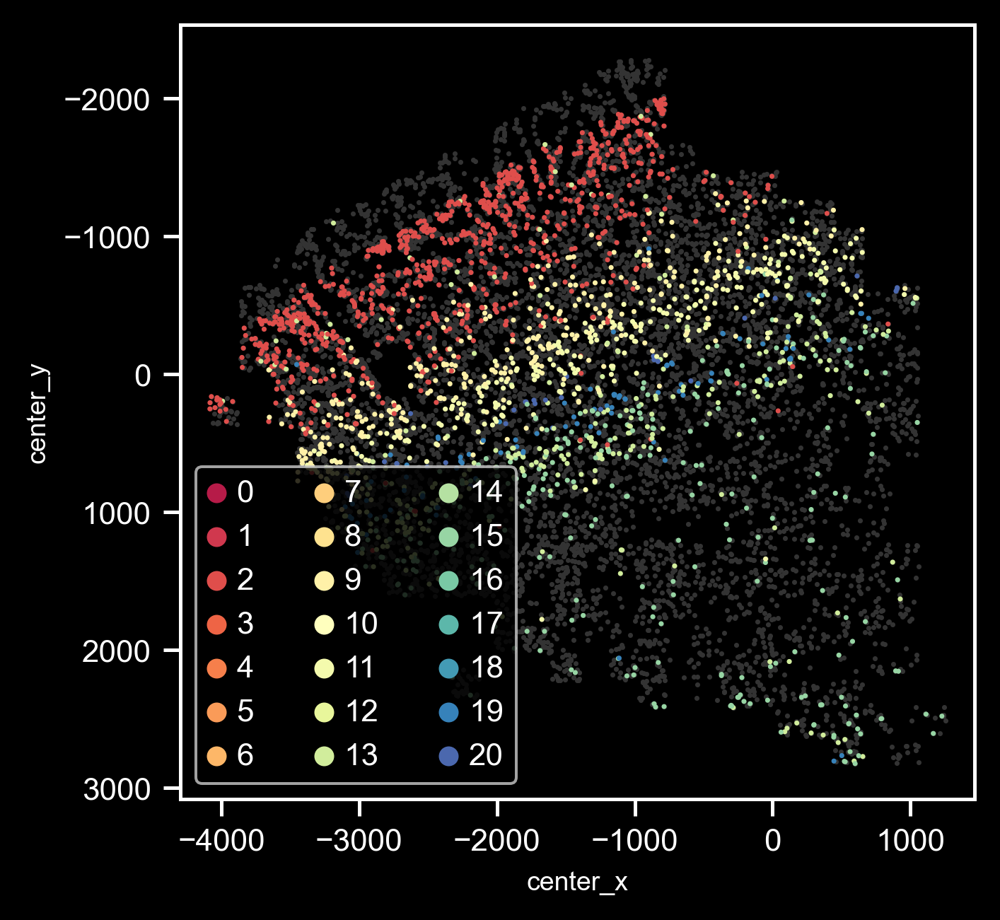

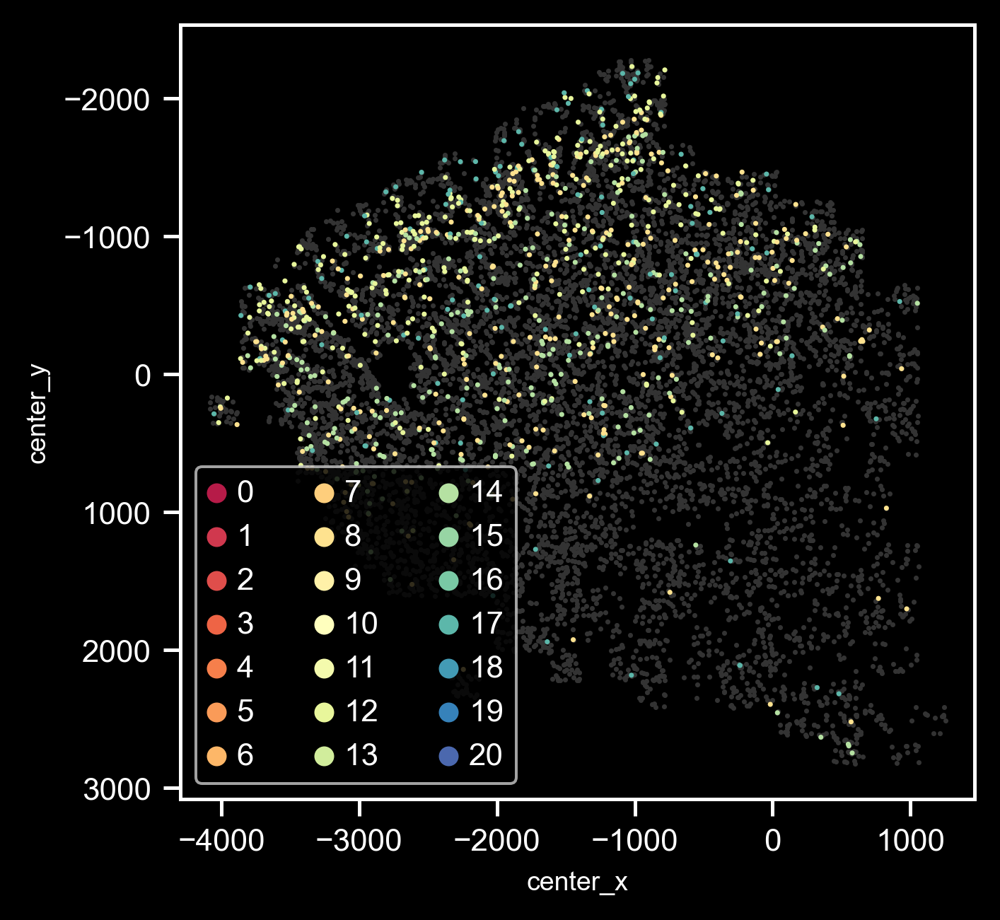

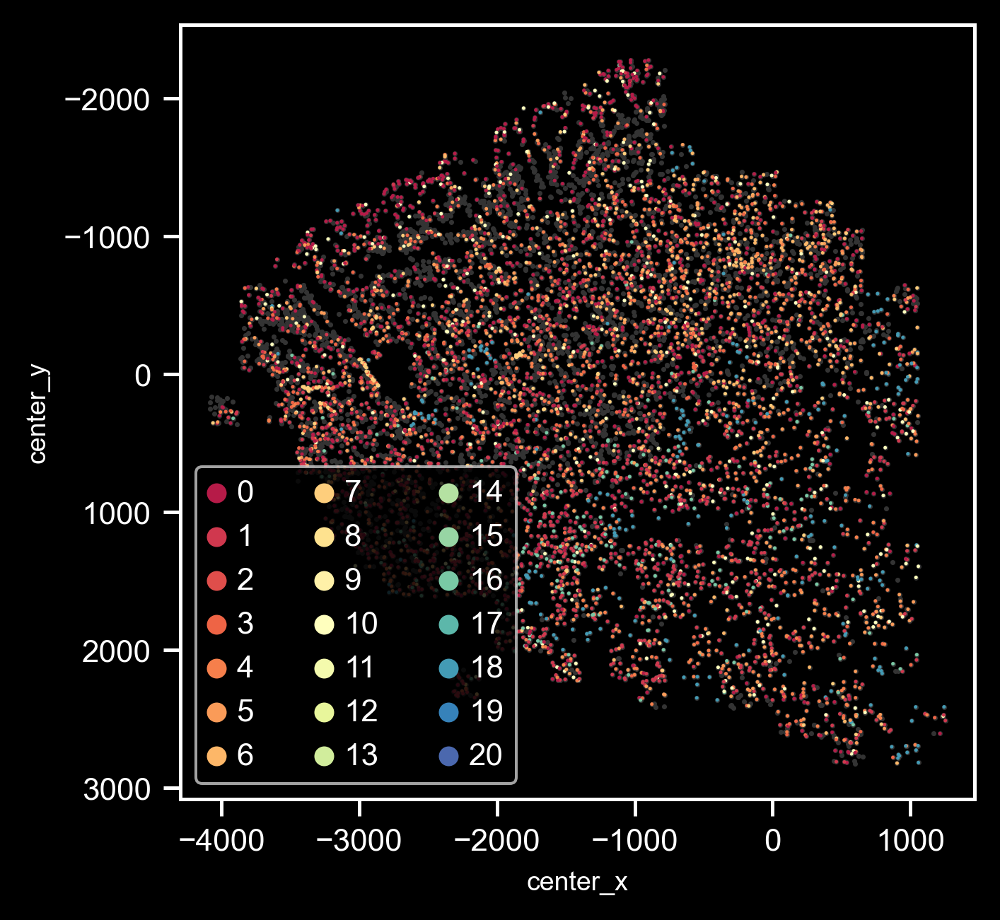

In [35]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]


_current_background = np.array( ax.get_facecolor() )
ref_spot_color = np.abs(_current_background[:3] - 0.2)
ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=ref_spot_color, s=2, legend=True, linewidth=0)
ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)


ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=ref_spot_color, s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=ref_spot_color, s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

In [36]:
sel_experiment_id = 2
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]

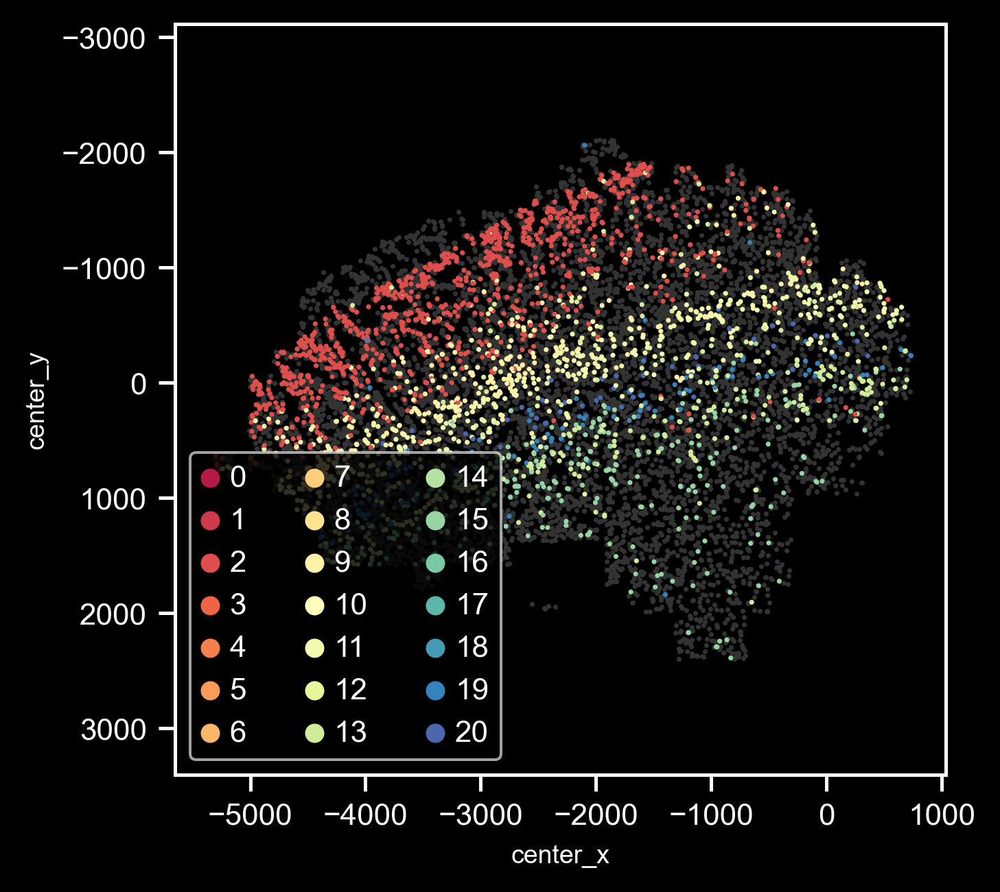

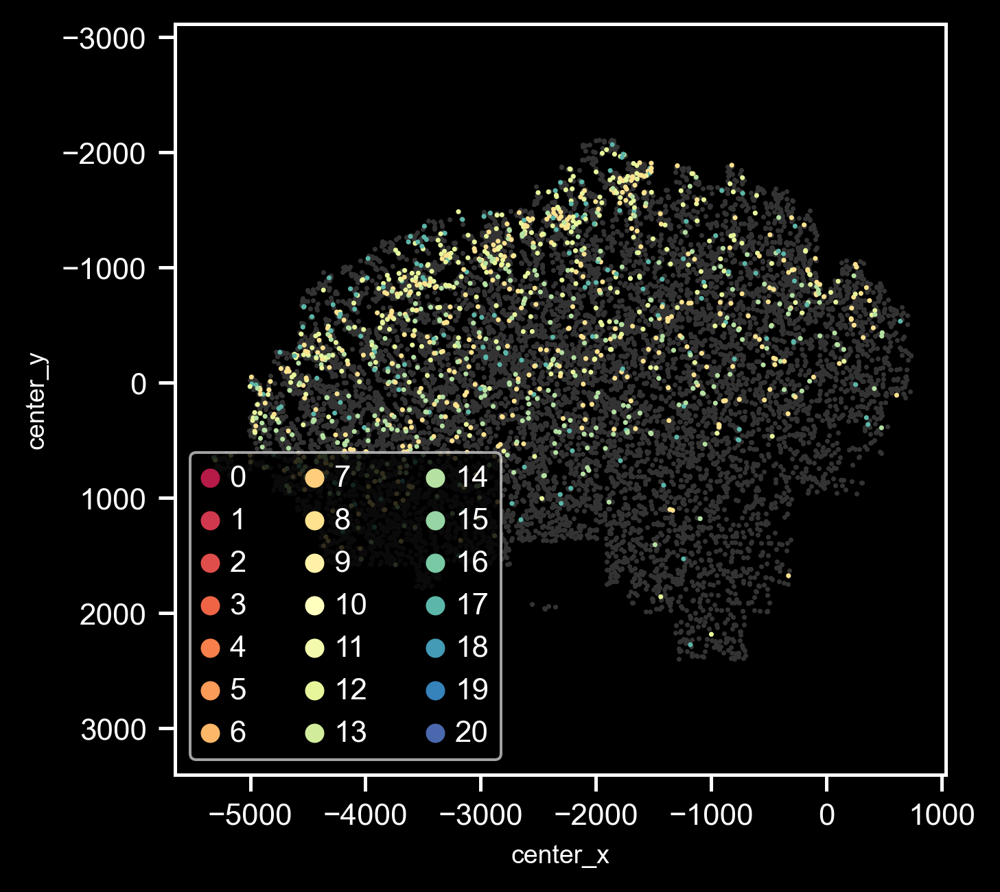

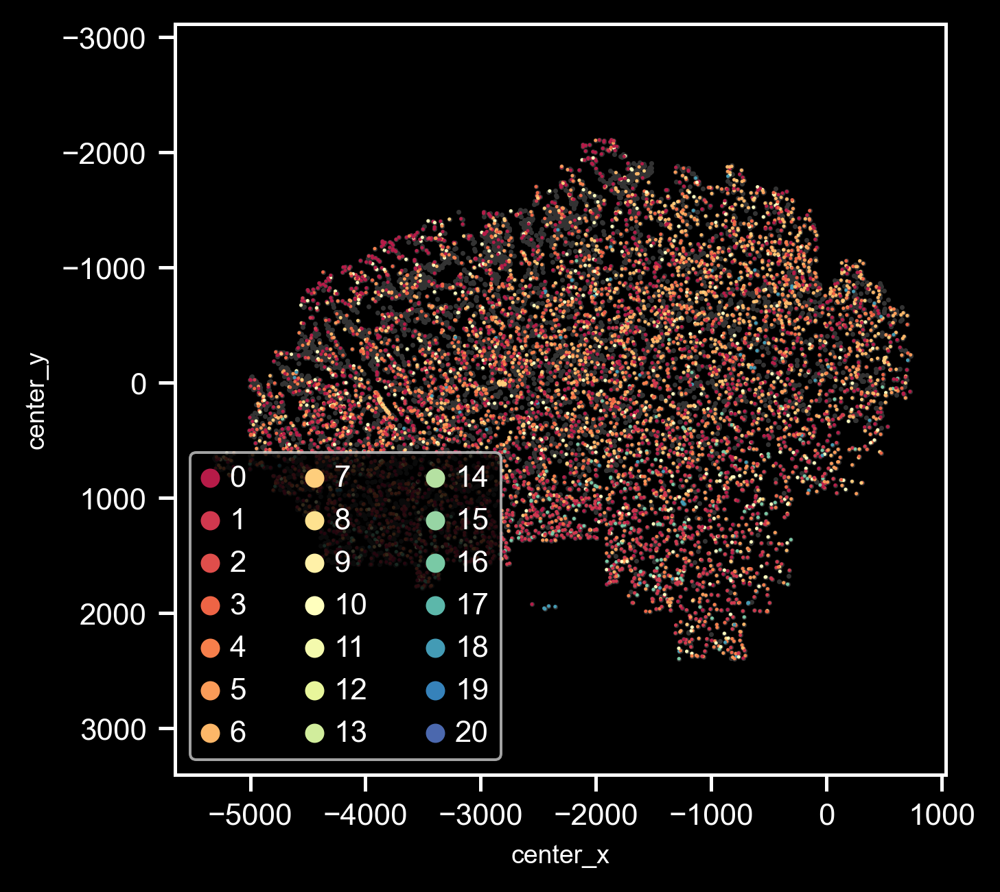

In [37]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]


_current_background = np.array( ax.get_facecolor() )
ref_spot_color = np.abs(_current_background[:3] - 0.2)
ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=ref_spot_color, s=2, legend=True, linewidth=0)
ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)


ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=ref_spot_color, s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=ref_spot_color, s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

# 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [38]:

save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')
#save_filename = os.path.join(save_folder, 'filtered_cluster_data_v2.h5ad')
overwrite = False

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: I:\MERFISH_Analysis\hM1_hM1-Cx28_summary_new_segmentation\filtered_cluster_data.h5ad


# 8. co-embed TBD

In [161]:
seq_ref_folder = r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\human\10xM1'
sel_seq_raw_filename = os.path.join(seq_ref_folder, 'sel_hM1_10x_raw.h5ad')
print(sel_seq_raw_filename)
seq_raw_adata = sc.read_h5ad(sel_seq_raw_filename)

\\10.245.74.158\Chromatin_NAS_8\MERFISH\human\10xM1\sel_hM1_10x_raw.h5ad


In [163]:
merfish_raw_adata = sc.read_h5ad(filtered_filename)


In [164]:
# Normalize and scale the data
sc.pp.normalize_total(seq_raw_adata, target_sum=1000)
sc.pp.log1p(seq_raw_adata)
sc.pp.scale(seq_raw_adata)

sc.pp.normalize_total(merfish_raw_adata, target_sum=1000)
sc.pp.log1p(merfish_raw_adata)
sc.pp.scale(merfish_raw_adata)

In [165]:
# Merge the datasets
adata_merge = seq_raw_adata.concatenate(merfish_raw_adata,
                                    batch_categories=['seq', 'merfish'],
                                    batch_key='modality',
                                    index_unique=None)

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\anndata\_core\anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [167]:
%%time
# Get the significant PCs
n_pcs = 100
sc.tl.pca(adata_merge, svd_solver='arpack', n_comps=100)

Wall time: 1.5 s


In [168]:
adata_list = [adata_merge[adata_merge.obs['modality'] == 'seq'],
              adata_merge[adata_merge.obs['modality'] == 'merfish']
             ]

In [199]:
adata_merge

AnnData object with n_obs × n_vars = 105801 × 260
    obs: 'exp_component_name', 'cluster_label', 'cluster_color', 'cluster_order', 'class_label', 'class_color', 'class_order', 'subclass_label', 'subclass_color', 'subclass_order', 'donor_sex_label', 'donor_sex_color', 'donor_sex_order', 'region_label', 'region_color', 'region_order', 'cortical_layer_label', 'cortical_layer_color', 'cortical_layer_order', 'cell_type_accession_label', 'cell_type_accession_color', 'cell_type_accession_order', 'cell_type_alias_label', 'cell_type_alias_color', 'cell_type_alias_order', 'cell_type_alt_alias_label', 'cell_type_alt_alias_color', 'cell_type_alt_alias_order', 'cell_type_designation_label', 'cell_type_designation_color', 'cell_type_designation_order', 'external_donor_name_label', 'external_donor_name_color', 'external_donor_name_order', 'specimen_type', 'full_genotype_label', 'outlier_call', 'outlier_type', 'n_genes_by_counts', 'total_counts', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'max

In [198]:
adata_list

[View of AnnData object with n_obs × n_vars = 76533 × 260
     obs: 'exp_component_name', 'cluster_label', 'cluster_color', 'cluster_order', 'class_label', 'class_color', 'class_order', 'subclass_label', 'subclass_color', 'subclass_order', 'donor_sex_label', 'donor_sex_color', 'donor_sex_order', 'region_label', 'region_color', 'region_order', 'cortical_layer_label', 'cortical_layer_color', 'cortical_layer_order', 'cell_type_accession_label', 'cell_type_accession_color', 'cell_type_accession_order', 'cell_type_alias_label', 'cell_type_alias_color', 'cell_type_alias_order', 'cell_type_alt_alias_label', 'cell_type_alt_alias_color', 'cell_type_alt_alias_order', 'cell_type_designation_label', 'cell_type_designation_color', 'cell_type_designation_order', 'external_donor_name_label', 'external_donor_name_color', 'external_donor_name_order', 'specimen_type', 'full_genotype_label', 'outlier_call', 'outlier_type', 'n_genes_by_counts', 'total_counts', 'fov', 'volume', 'center_x', 'center_y', 'min

# Integration

In [169]:
import ALLCools
from ALLCools.integration.seurat_class import SeuratIntegration

ModuleNotFoundError: No module named 'ALLCools'

In [173]:
sc.external.pp.harmony_integrate(adata_merge, key='modality')

2022-11-07 09:08:37,816 - harmonypy - INFO - Iteration 1 of 10
2022-11-07 09:10:22,466 - harmonypy - INFO - Iteration 2 of 10
2022-11-07 09:11:52,337 - harmonypy - INFO - Iteration 3 of 10
2022-11-07 09:12:50,942 - harmonypy - INFO - Iteration 4 of 10
2022-11-07 09:14:30,103 - harmonypy - INFO - Iteration 5 of 10
2022-11-07 09:15:36,405 - harmonypy - INFO - Iteration 6 of 10
2022-11-07 09:16:19,295 - harmonypy - INFO - Iteration 7 of 10
2022-11-07 09:17:02,885 - harmonypy - INFO - Iteration 8 of 10
2022-11-07 09:17:46,026 - harmonypy - INFO - Converged after 8 iterations


In [177]:
adata_merge

AnnData object with n_obs × n_vars = 105801 × 260
    obs: 'exp_component_name', 'cluster_label', 'cluster_color', 'cluster_order', 'class_label', 'class_color', 'class_order', 'subclass_label', 'subclass_color', 'subclass_order', 'donor_sex_label', 'donor_sex_color', 'donor_sex_order', 'region_label', 'region_color', 'region_order', 'cortical_layer_label', 'cortical_layer_color', 'cortical_layer_order', 'cell_type_accession_label', 'cell_type_accession_color', 'cell_type_accession_order', 'cell_type_alias_label', 'cell_type_alias_color', 'cell_type_alias_order', 'cell_type_alt_alias_label', 'cell_type_alt_alias_color', 'cell_type_alt_alias_order', 'cell_type_designation_label', 'cell_type_designation_color', 'cell_type_designation_order', 'external_donor_name_label', 'external_donor_name_color', 'external_donor_name_order', 'specimen_type', 'full_genotype_label', 'outlier_call', 'outlier_type', 'n_genes_by_counts', 'total_counts', 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'max

In [ ]:
use_rep='X_pca_harmony'

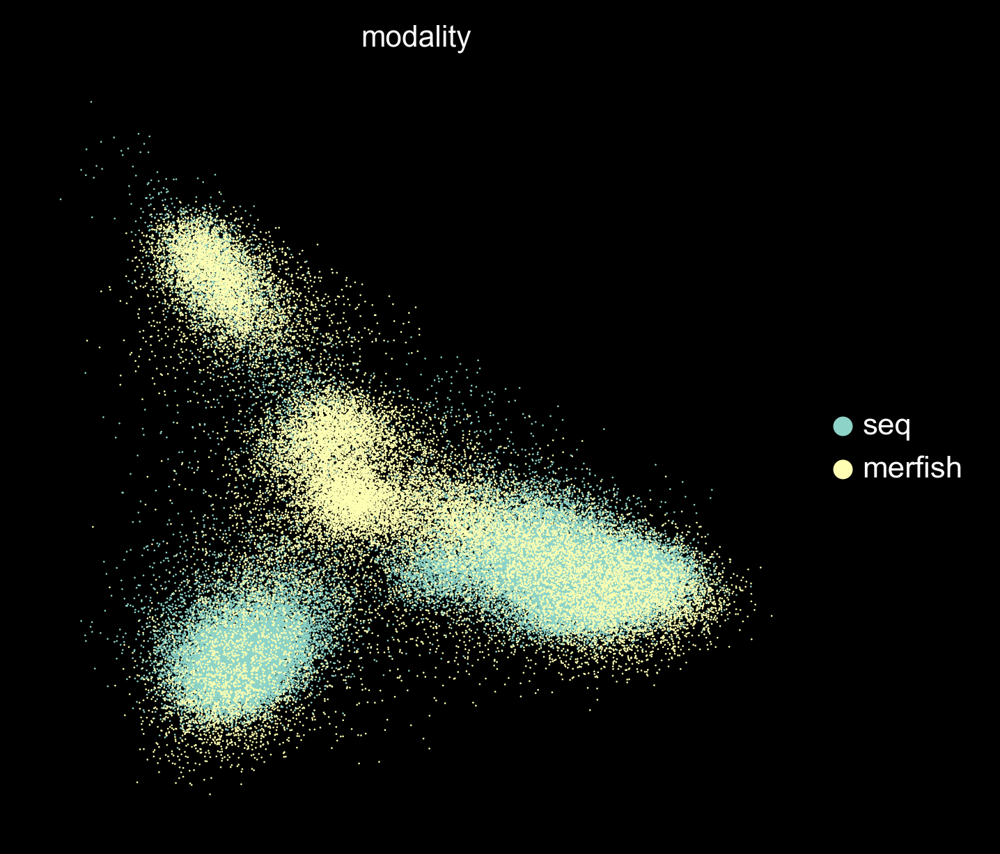

In [183]:
sc.pl.embedding( adata_merge, basis='X_pca_harmony', color=['modality'])


In [185]:
sc.pp.neighbors(adata_merge, use_rep='X_pca_harmony', n_neighbors=8, n_pcs=30)

In [286]:
# Clustering
sc.tl.leiden(adata_merge, resolution=1)

In [287]:
%%time
# Embed with UMAP
sc.tl.umap(adata_merge)

Wall time: 1min 22s


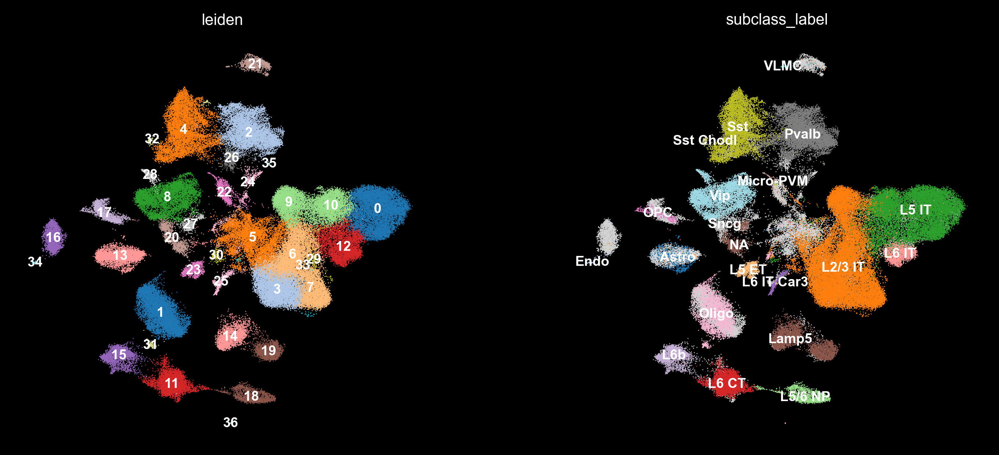

Wall time: 4.23 s


In [294]:
%%time
# Plot the UMAP
sc.pl.umap(adata_merge, color=['leiden', 'subclass_label'], 
           legend_loc='on data',
           palette='tab20',
           save='_integrate_init_cluster.png',
           )

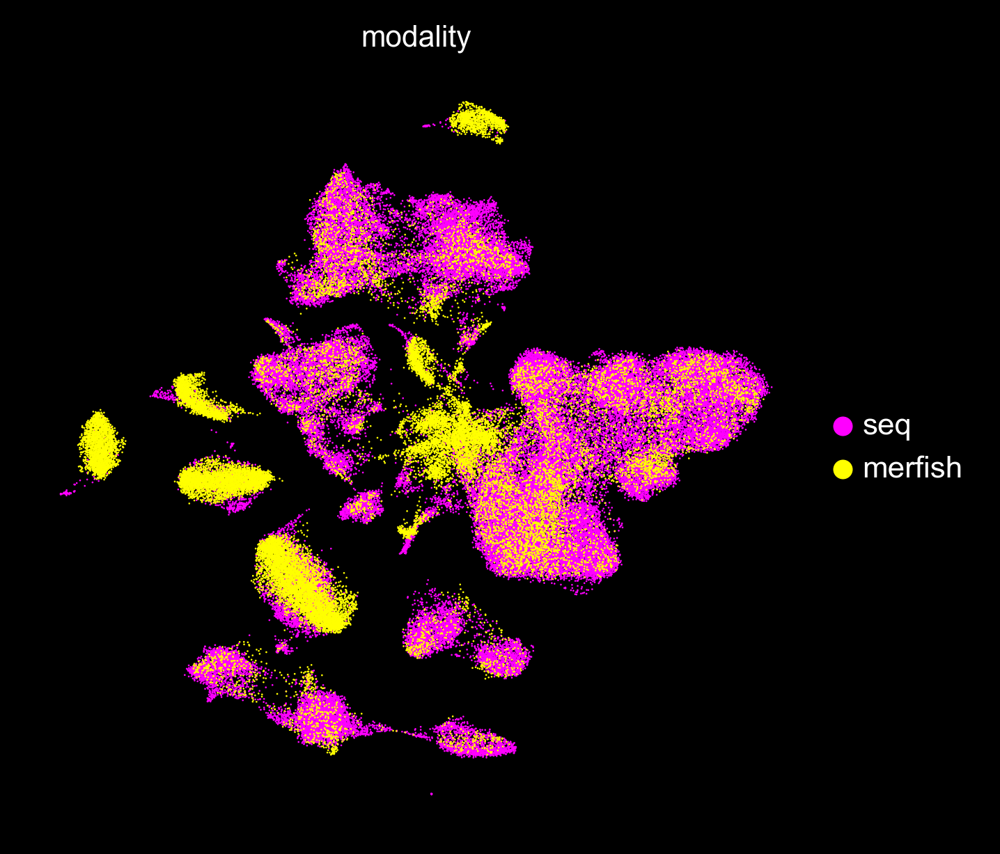

Wall time: 2.02 s


In [289]:
%%time
# Plot the UMAP
sc.pl.umap(adata_merge, color=['modality'], 
           #legend_loc='on data',
           palette='spring',
           save='_integrate_modality.png',
           )

# Transfer label given integration

In [290]:
labeled_col = 'subclass_label'
cluster_col = 'leiden'
target_col = 'mapped_' + labeled_col

#adata_merge.obs

In [325]:
# overlap
min_cluster_size = 50
assign_threshold = 0.5
valid_threshold = 0.05

assigned_cluster_2_fraction = {}
unassigned_cluster_2_fraction = {}

adata_merge.obs[target_col] = adata_merge.obs[labeled_col].copy()

for _cluster in np.unique(adata_merge.obs[cluster_col]):
    _sel_obs = adata_merge.obs.loc[adata_merge.obs[cluster_col]==_cluster]
    if len(_sel_obs) < min_cluster_size:
        continue
    # map fraction
    _sel_labels = np.array(_sel_obs[labeled_col].values)
    _valid_flags = np.array([_l is not np.nan for _l in _sel_labels])
    _valid_fraction = np.sum(_valid_flags) / len(_sel_labels)
    
    _sel_labels = _sel_labels[_valid_flags]
    _labels, _label_counts = np.unique(_sel_labels, return_counts=True)
    _label_fractions = _label_counts / np.sum(_valid_flags)
    # assign
    if np.max(_label_fractions) > assign_threshold and _valid_fraction > valid_threshold:
        adata_merge.obs.loc[adata_merge.obs[cluster_col]==_cluster, target_col] = _labels[np.argmax(_label_fractions)]
        # append to assigned
        assigned_cluster_2_fraction[_cluster] = {'labels': _labels, 'fractions': _label_fractions}
    else:
        adata_merge.obs.loc[adata_merge.obs[cluster_col]==_cluster, target_col] = pd.DataFrame(['Unknown'])
        # append to assigned
        unassigned_cluster_2_fraction[_cluster] = {'labels': _labels, 'fractions': _label_fractions}


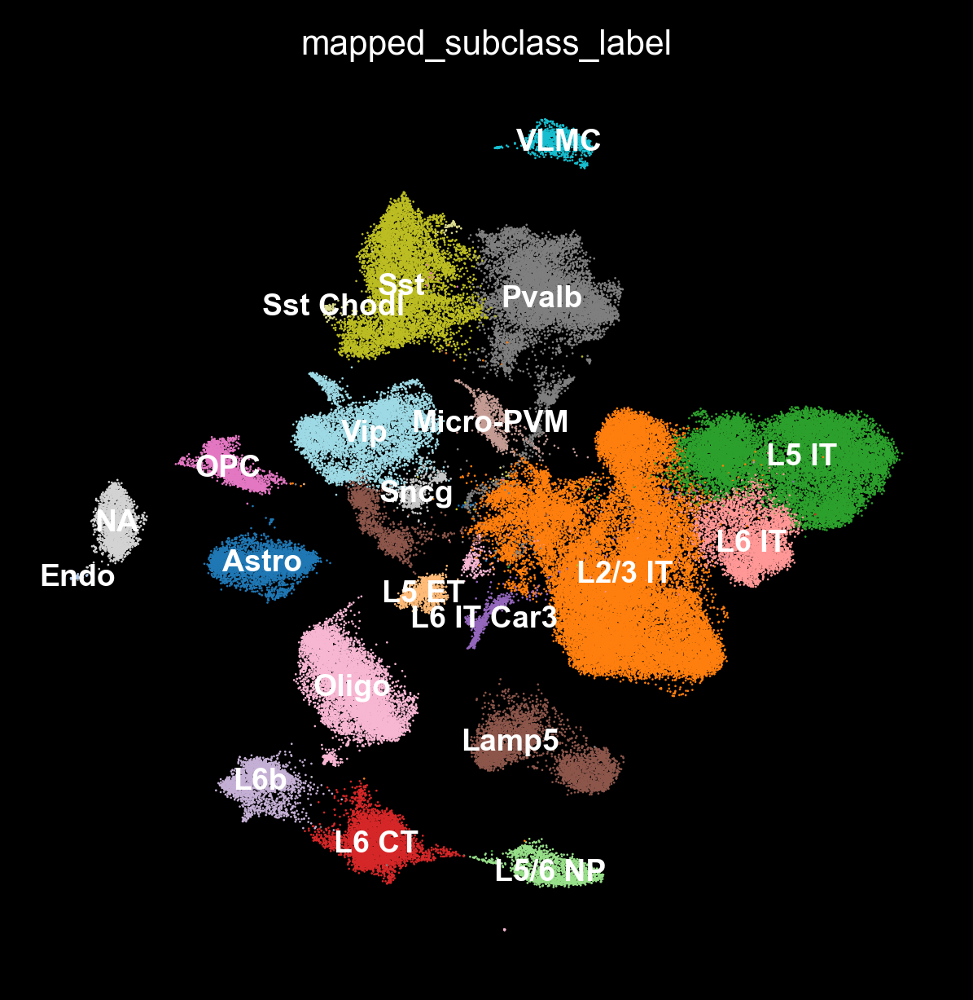

Wall time: 2.01 s


In [326]:
%%time
# Plot the UMAP
sc.pl.umap(adata_merge, color=[target_col], 
           legend_loc='on data',
           palette='tab20',
           save='_transferred_labels.png',
           )

In [298]:
experiments = np.unique([_l for _l in adata_merge.obs['experiment'] if _l is not np.nan])

In [313]:
sel_experiment_id = 2
sel_obs = adata_merge.obs.loc[adata_merge.obs['experiment']==experiments[sel_experiment_id]]

In [301]:
cluster_col

'leiden'

In [306]:
sel_inds

[]

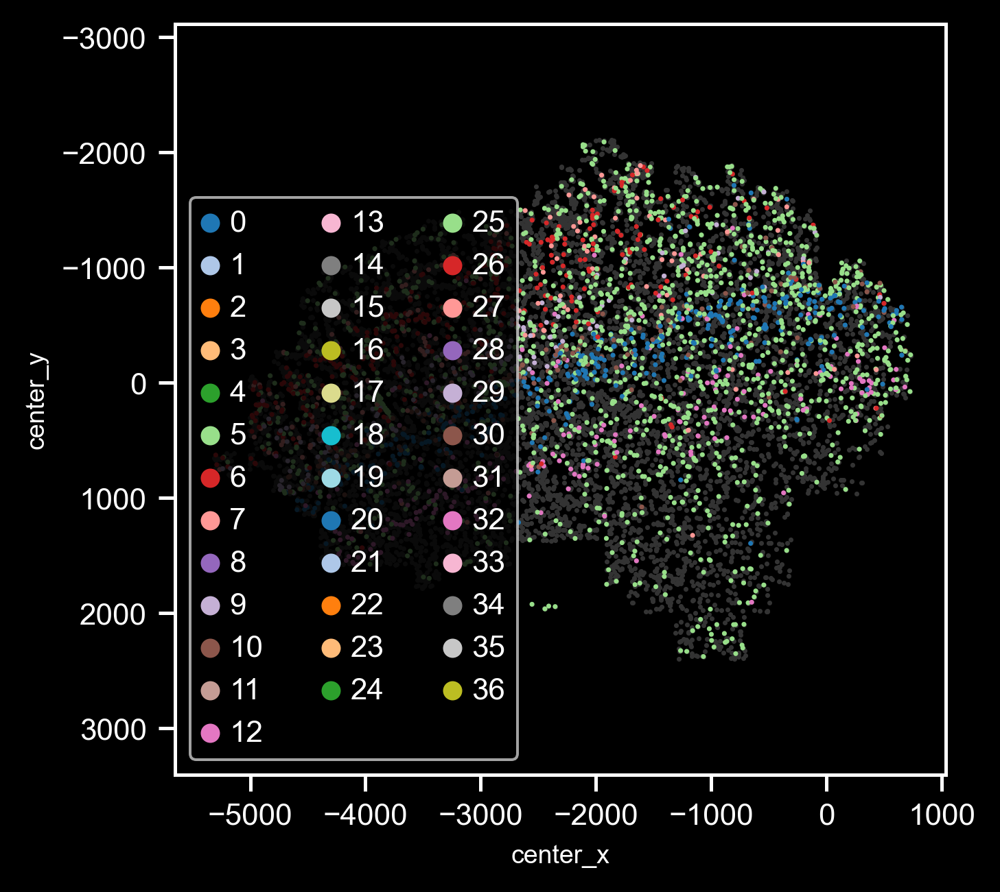

In [321]:

#sel_clusters = [str(_cls) for _cls in sel_obs[cluster_col]]
sel_clusters = [str(_c) for _c in [5,0,10,12,7,6,9]]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs[cluster_col]) if str(_cls) in sel_clusters]


_current_background = np.array( ax.get_facecolor() )
ref_spot_color = np.abs(_current_background[:3] - 0.2)
ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=ref_spot_color, s=2, legend=True, linewidth=0)
ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue=cluster_col, s=2, legend=True, linewidth=0)


ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
#plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

In [274]:
adata_merge.obs.loc[adata_merge.obs[cluster_col]==_cluster, target_col]

CAAAGAAGTCATAAAG-LKTX_190129_01_A01        Sncg
CCTCAGTTCGTCTAAG-LKTX_190129_01_A01        Sncg
TCTAACTCAAAGCACG-LKTX_190129_01_A01        Sncg
ATTCTTGGTCCTCATC-LKTX_190129_01_B01         Vip
GAGCCTGTCACGGGAA-LKTX_190129_01_B01        Sncg
                                           ... 
140918794327685795239090796436762174131     NaN
189355778766288739254638821728364443034     NaN
327409876278196096253461881579854242514     NaN
326019758040695377014061679222969539367     NaN
240606475655767983897574842406727606765     NaN
Name: mapped_subclass_label, Length: 1153, dtype: category
Categories (20, object): ['Astro', 'Endo', 'L2/3 IT', 'L5 ET', ..., 'Sst', 'Sst Chodl', 'VLMC', 'Vip']

In [267]:
type(_labels[np.argmax(_label_fractions)])

str

In [268]:
type('Unknown')

str

In [263]:
assigned_cluster_2_fraction

{'0': {'labels': array(['L2/3 IT', 'L5 IT', 'L6 IT', 'Oligo'], dtype=object),
  'fractions': array([9.93264558e-01, 6.47966579e-03, 1.70517521e-04, 8.52587603e-05])}}

In [271]:
_labels

array(['Lamp5', 'Sncg', 'Vip'], dtype=object)

In [272]:
_label_fractions

array([0.54302671, 0.43818002, 0.01879327])

In [270]:
type(_labels[np.argmax(_label_fractions)])

str

In [227]:
type(_sel_labels[-1])

float

array([ True,  True,  True, ..., False, False, False])

In [232]:
_sel_labels[-1] is np.nan

True

In [231]:
type(_sel_labels[-1])

float

In [205]:
_sel_obs

,exp_component_name,cluster_label,cluster_color,cluster_order,class_label,class_color,class_order,subclass_label,subclass_color,subclass_order,...,center_y,min_x,max_x,min_y,max_y,experiment,doublet_score,predicted_doublet,modality,leiden
AAACGAAGTTATGTGC-LKTX_190129_01_A01,AAACGAAGTTATGTGC-21L8TX_180927_001_A01,Exc L3 LAMP5 CARM1P1,#93d92b,78.0,Glutamatergic,#3DCC3D,2.0,L2/3 IT,#C4EC04,7.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,seq,0
AAAGAACAGCGATGGT-LKTX_190129_01_A01,AAAGAACAGCGATGGT-21L8TX_180927_001_A01,Exc L3 LAMP5 CARM1P1,#93d92b,78.0,Glutamatergic,#3DCC3D,2.0,L2/3 IT,#C4EC04,7.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,seq,0
AAAGGATAGCCAAGGT-LKTX_190129_01_A01,AAAGGATAGCCAAGGT-21L8TX_180927_001_A01,Exc L3 LAMP5 CARM1P1,#93d92b,78.0,Glutamatergic,#3DCC3D,2.0,L2/3 IT,#C4EC04,7.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,seq,0
AACAAAGAGATACCAA-LKTX_190129_01_A01,AACAAAGAGATACCAA-21L8TX_180927_001_A01,Exc L3 LAMP5 CARM1P1,#93d92b,78.0,Glutamatergic,#3DCC3D,2.0,L2/3 IT,#C4EC04,7.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,seq,0
AACAAGAGTTCGGTCG-LKTX_190129_01_A01,AACAAGAGTTCGGTCG-21L8TX_180927_001_A01,Exc L3 LAMP5 CARM1P1,#93d92b,78.0,Glutamatergic,#3DCC3D,2.0,L2/3 IT,#C4EC04,7.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,seq,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111716380357029006061765623993215058232,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,220.296008,423.181203,429.466803,216.829208,223.762808,20221026,0.018569,False,merfish,0
322880825620123737252961719998783270445,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-113.941990,424.693203,436.054803,-118.758790,-109.125190,20221026,0.041773,False,merfish,0
124333461594644356822148739059244245132,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,48.560002,594.377202,602.714802,45.633202,51.486802,20221026,0.016922,False,merfish,0
144176053292874964782019111913905045063,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,752.715975,-5269.258798,-5262.109198,746.387175,759.044775,20221026,0.061883,False,merfish,0


# Run classifier

## cleanup downloaded data

downloaded from:
https://portal.brain-map.org/atlases-and-data/rnaseq/human-m1-10x


In [39]:
# Only run this for the first time!
overwrite = False
seq_ref_folder = r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\human\10xM1'
# adata file
sel_seq_raw_filename = os.path.join(seq_ref_folder, 'sel_hM1_10x_raw.h5ad')
print(sel_seq_raw_filename)
# load
sel_seq_adata = sc.read_h5ad(sel_seq_raw_filename)
# calculate metric
sc.pp.calculate_qc_metrics(sel_seq_adata, percent_top=None, log1p=False, inplace=True)

\\10.245.74.158\Chromatin_NAS_8\MERFISH\human\10xM1\sel_hM1_10x_raw.h5ad


In [40]:
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
median_cell_count = np.median(np.sum(sel_seq_adata.X, axis=1))
print(median_cell_count)
sc.pp.normalize_total(sel_seq_adata, target_sum=median_cell_count)
# Logarithmize the data
sc.pp.log1p(sel_seq_adata)
# Regress out total counts
#sc.pp.regress_out(sel_seq_adata, 'total_counts')

294.0


## if processed 10x data not exits, go to jupyter:
/Merfish_Analysis_Scripts/post_analysis/Process_hM1_10x_seq_data.ipynb
        

# MLP

In [41]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as utils_data
from torch.autograd import Variable
import torch.optim as optim
#cell_by_gene = Variable(torch.Tensor(x.values))

In [42]:
class MLP_classifier(nn.Module):
    """MLP classfier"""
    def __init__(self, n_inputs, hidden_size, n_classes): 
        super().__init__()
        # self params
        self.hidden_size = hidden_size
        self.n_classes = n_classes
        # Create fully connected layers
        self.l1 = nn.Linear(n_inputs, hidden_size)
        self.l2 = nn.Linear(hidden_size, hidden_size)
        self.l3 = nn.Linear(hidden_size, n_classes)
        
    def forward(self, x, activation_func='relu', classification_func='softmax'):
        """Apply these layers """
        _activation_func = getattr(F, activation_func)
        _classification_func = getattr(F, classification_func)
        # x = x.view(-1, n_inputs)
        x = _activation_func(self.l1(x))
        x = _activation_func(self.l2(x))
        x = _activation_func(self.l3(x))
        x = _classification_func(x, dim=1)
        return x
    
def train_mlpc(model, train_loader, optimizer='Adam', loss_func='MSELoss', 
               learing_rate=1e-3, weight_decay=1e-4, num_epoch=256, device=None):
    
    model.train()
    if not hasattr(model, 'loss_records'):
        setattr(model, 'loss_records', [])
    if not hasattr(model, 'acc_records'):
        setattr(model, 'acc_records', [])
    
    _optimizer = getattr(optim, optimizer)(model.parameters(), lr=learing_rate, weight_decay=weight_decay)
    _loss_func = getattr(nn, loss_func)()
    # default device
    if device == None:
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
    for epoch in range(num_epoch):
        # init loss
        total_loss = 0.
        n_total = 0.
        n_correct = 0.
        # loop
        for _batch_ind, (data, target) in enumerate(train_loader):
            # make prediction based on current model
            _tr_x, _tr_y = data.to(device), target.to(device)
            _pred = model(_tr_x)
            # calculate loss
            _loss = _loss_func(_pred, F.one_hot(_tr_y, model.n_classes).float())
            total_loss += _loss
            # init grad
            _optimizer.zero_grad()
            # propagate backward
            _loss.backward()
            # optimize parameters
            _optimizer.step()
            # store info for accuracy calculation
            n_total += _tr_y.size(0)
            n_correct += (_pred.argmax(-1) == _tr_y).sum().item()
        # append
        model.loss_records.append(total_loss.cpu().item())
        model.acc_records.append(n_correct/n_total)
        # print message
        if epoch % 5 == 0:
            _test_acc = test_mlpc(model, test_data_loader)
            print (f'Epoch [{epoch+1}/{num_epoch}]\tLoss: {total_loss:.4f}\tACC: {n_correct/n_total:.4f}')
            print(_test_acc)
            
            
def test_mlpc(model, test_loader):
    # accuracy
    n_total = 0.
    n_correct = 0.
    for _batch_ind, (data, target) in enumerate(test_loader):
        # make prediction based on current model
        _tr_x, _tr_y = data.to(device), target.to(device)
        _pred = model(_tr_x)
        # store info for accuracy calculation
        n_total += _tr_y.size(0)
        n_correct += (_pred.argmax(-1) == _tr_y).sum().item()
    return n_correct / n_total


In [45]:
n_classes = len(np.unique(sel_seq_adata.obs['subclass_label'].to_list()))

subclass_2_int = {
    _c:_i for _i, _c in enumerate(np.unique(sel_seq_adata.obs['subclass_label'].to_list()))
}
subclass_ints = np.array([subclass_2_int[_c] for _c in sel_seq_adata.obs['subclass_label']], dtype=np.int32)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

pred_model = MLP_classifier(len(sel_seq_adata.var), 256, n_classes, ).to(device)

In [46]:
# convert inputs
inputs = Variable(torch.tensor(sel_seq_adata.X))
targets = Variable(torch.tensor(subclass_ints, dtype=torch.long))

n_sample_train = int(inputs.size(0) * 0.9)
n_sample_test = inputs.size(0) - n_sample_train

all_samples = utils_data.TensorDataset(inputs, targets)
train_samples, test_samples = utils_data.random_split(all_samples, lengths=[n_sample_train, n_sample_test])

train_data_loader = utils_data.DataLoader(train_samples, batch_size=200, drop_last=False, shuffle=True)
test_data_loader = utils_data.DataLoader(test_samples, batch_size=200, drop_last=False, shuffle=True)


In [65]:
train_mlpc(pred_model, train_data_loader, num_epoch=50, learing_rate=1e-3, loss_func='CrossEntropyLoss')

Epoch [1/50]	Loss: 720.3933	ACC: 0.9916
0.9839299712568591
Epoch [6/50]	Loss: 720.0648	ACC: 0.9925
0.9844525738176118
Epoch [11/50]	Loss: 720.0592	ACC: 0.9926
0.9821008622942252
Epoch [16/50]	Loss: 719.8945	ACC: 0.9930
0.9841912725372355
Epoch [21/50]	Loss: 719.7935	ACC: 0.9933
0.9849751763783643
Epoch [26/50]	Loss: 719.8420	ACC: 0.9931
0.981839561013849
Epoch [31/50]	Loss: 719.7468	ACC: 0.9934
0.9852364776587406
Epoch [36/50]	Loss: 719.6586	ACC: 0.9937
0.9834073686961066
Epoch [41/50]	Loss: 719.7589	ACC: 0.9935
0.982884766135354
Epoch [46/50]	Loss: 719.5189	ACC: 0.9941
0.9839299712568591


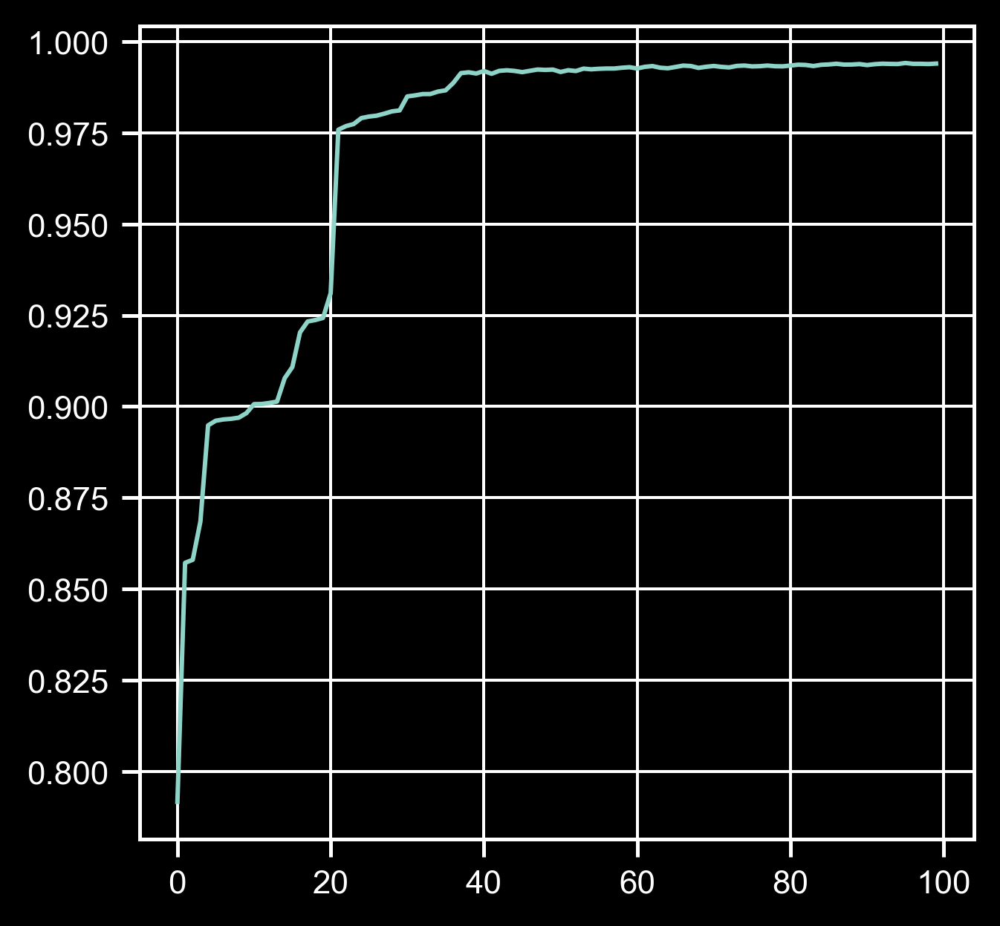

In [66]:
plt.figure()
plt.plot(pred_model.acc_records)
plt.show()

# M1adata

In [49]:
merfish_adata = sc.read_h5ad(filtered_filename)
# calculate metric
sc.pp.calculate_qc_metrics(merfish_adata, percent_top=None, log1p=False, inplace=True)
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(merfish_adata, target_sum=np.median(merfish_adata.obs['total_counts']))
# Logarithmize the data
sc.pp.log1p(merfish_adata)
# Regress out total counts
#sc.pp.regress_out(merfish_adata, 'total_counts')

In [67]:
pred_samples = Variable(torch.tensor(merfish_adata.X))

pred_ints = pred_model(pred_samples.to(device)).argmax(-1).cpu().numpy()

int_2_subclass = {_v:_k for _k,_v in subclass_2_int.items()}
pred_subclasses = [int_2_subclass[_pi] for _pi in pred_ints]

In [68]:
if 'merged_adata' not in locals():
    save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')
    merged_adata = sc.read_h5ad(save_filename)
merged_adata.obs['pred_subclass'] = pred_subclasses

In [69]:
np.unique(pred_ints)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 19], dtype=int64)

In [70]:
merged_adata

AnnData object with n_obs × n_vars = 29268 × 260
    obs: 'fov', 'volume', 'center_x', 'center_y', 'min_x', 'max_x', 'min_y', 'max_y', 'experiment', 'n_genes_by_counts', 'total_counts', 'doublet_score', 'predicted_doublet', 'leiden', 'leiden_cluster', 'pred_subclass', 'leiden_subclass_sub'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mean', 'std'
    uns: 'scrublet', 'log1p', 'pca', 'experiment_colors', 'neighbors', 'leiden', 'umap', 'leiden_colors', 'rank_genes_groups', 'leiden_cluster_colors', 'pred_subclass_colors', 'leiden_subclass_sub_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

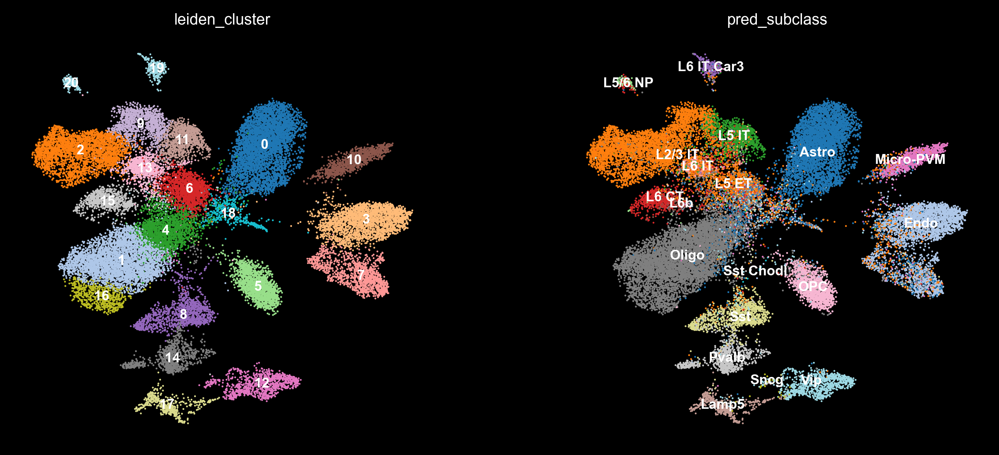

In [71]:
# Plot the UMAP
sc.pl.umap(merged_adata, color=['leiden_cluster', 'pred_subclass'], 
           legend_loc='on data',
           palette='tab20',
           save='_pred_cluster.png',
           )

In [72]:
merged_adata.obs['leiden_subclass_sub'] = merged_adata.obs['leiden_cluster'].copy()

sc.tl.leiden(merged_adata, resolution=0.2, restrict_to=('leiden_subclass_sub',['4']), key_added='leiden_subclass_sub')
sc.tl.leiden(merged_adata, resolution=0.2, restrict_to=('leiden_subclass_sub',['6']), key_added='leiden_subclass_sub')
sc.tl.leiden(merged_adata, resolution=0.2, restrict_to=('leiden_subclass_sub',['18']), key_added='leiden_subclass_sub')

sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['15']), key_added='leiden_subclass_sub')

sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['12']), key_added='leiden_subclass_sub')

#sc.tl.leiden(merged_adata, resolution=0.2, restrict_to=('leiden_subclass_sub',['17']), key_added='leiden_subclass_sub')

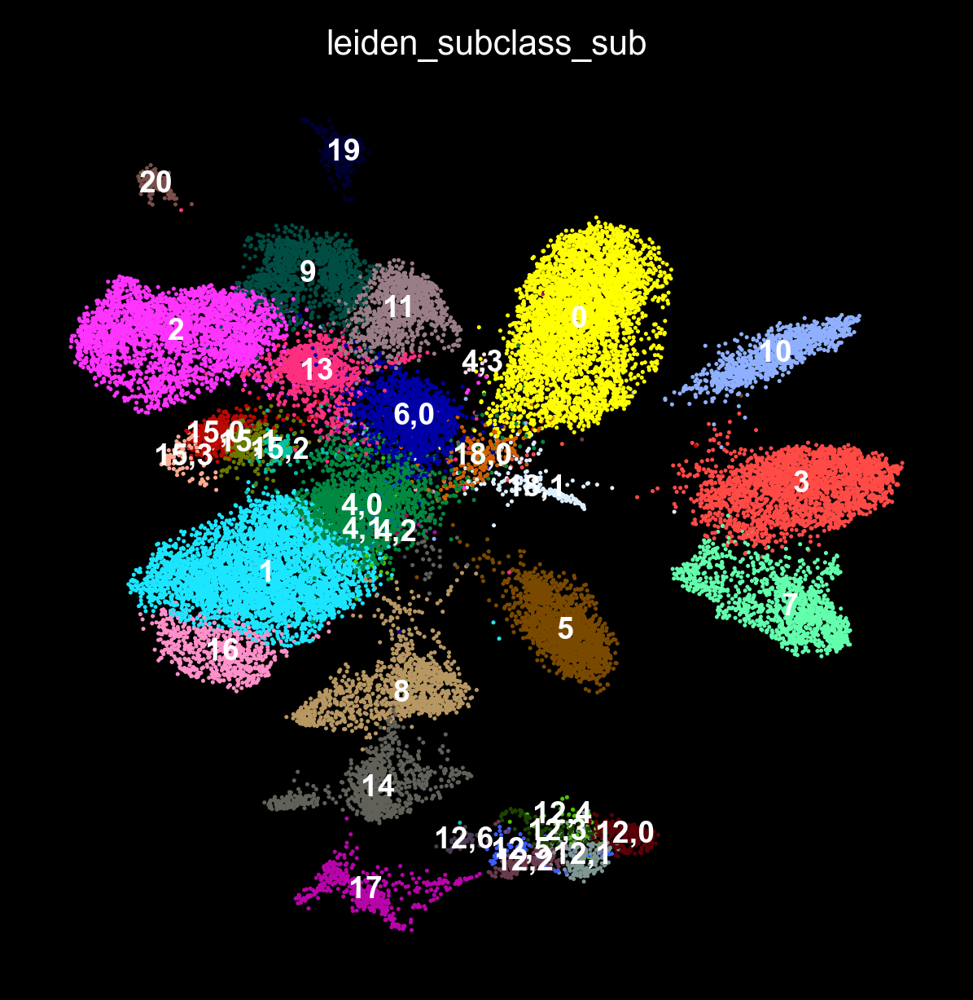

In [73]:
sc.pl.umap(merged_adata, color='leiden_subclass_sub', legend_loc='on data', cmap='Spectral')

## 8.5 further predict splitted groups

In [74]:
import sys
sys.path.append(r"..\..\..\Documents")
import ImageAnalysis3.celltype_tools.classifier as clsf

In [75]:
prediction_column = 'pred_subclass'

ref_cluster_column = 'leiden_cluster'

# determine which class to query
fine_query_cluster_column = 'leiden_subclass_sub'
#fine_query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
#clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = merged_adata.obs[[fine_query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[fine_query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')

Predict cell types.


C:\Users\puzheng_new\AppData\Local\Temp\2\ipykernel_19740\2755326626.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


In [76]:
np.sum(merged_adata.obs['leiden_subclass_sub']=='7')

1230

In [77]:
np.sum((merged_adata.obs['pred_subclass']=='VLMC'))

0

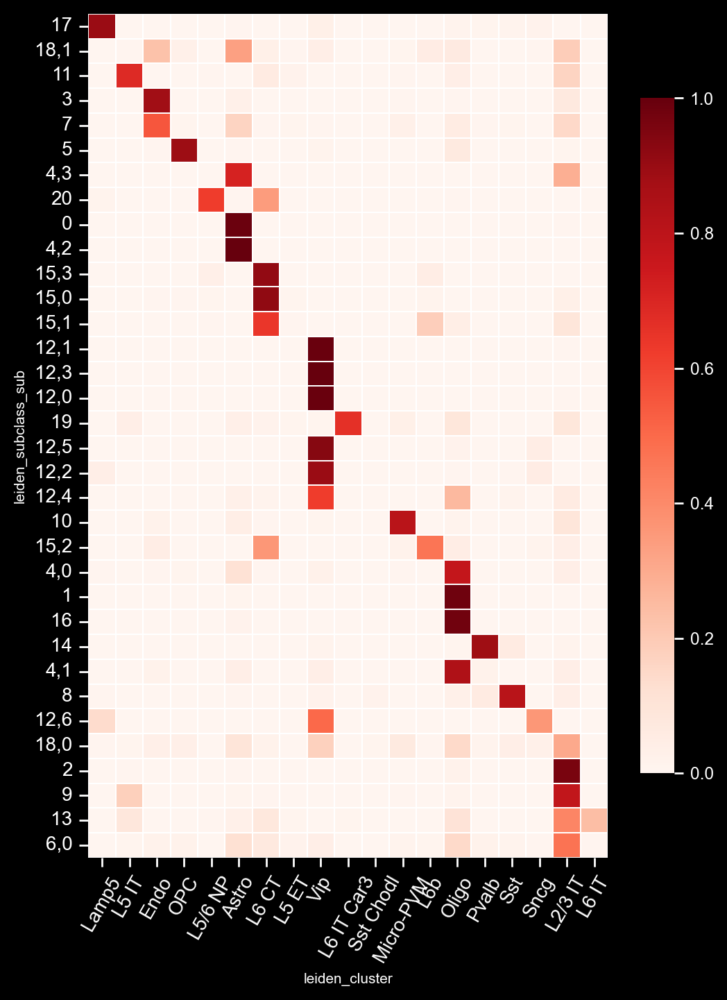

In [78]:
# Plot
fig1=plt.figure(figsize = (6,8), dpi=100)
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(fine_query_cluster_column)
plt.show()

In [80]:
first_assign_dict = {}
missed_classes = []
# Automatic assign best fit if applicable
assign_th = 0.5
for _cluster, _vec in fractions.iterrows():
    #_cluster, _vec
    _matched_inds = np.where(_vec >= assign_th)[0]
    # if uniquely matched:
    if len(_matched_inds) == 1:
        print(_cluster, list(_vec.keys())[_matched_inds[0]])
        first_assign_dict[_cluster] = list(_vec.keys())[_matched_inds[0]]
    else:
        missed_classes.append(_cluster)

0 Astro
1 Oligo
2 L2/3 IT
3 Endo
4,0 Oligo
4,1 Oligo
4,2 Astro
4,3 Astro
5 OPC
7 Endo
8 Sst
9 L2/3 IT
10 Micro-PVM
11 L5 IT
12,0 Vip
12,1 Vip
12,2 Vip
12,3 Vip
12,4 Vip
12,5 Vip
12,6 Vip
14 Pvalb
15,0 L6 CT
15,1 L6 CT
15,3 L6 CT
16 Oligo
17 Lamp5
19 L6 IT Car3
20 L5/6 NP


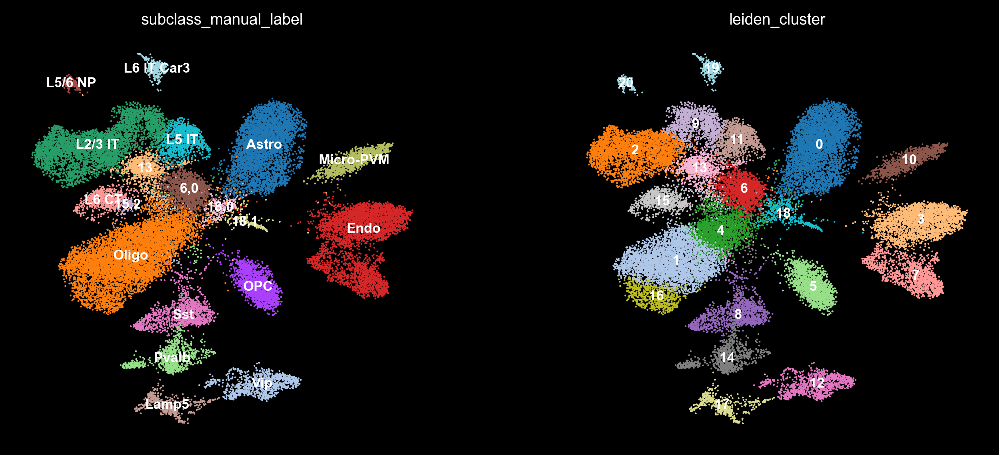

In [81]:
merged_adata.obs['subclass_manual_label'] = merged_adata.obs['leiden_subclass_sub'].copy()
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':first_assign_dict})
# Check the leftover
np.unique(merged_adata.obs['subclass_manual_label'])
# Plot the predicted sub-subclass
sc.pl.umap(merged_adata, color=['subclass_manual_label', 'leiden_cluster'], legend_loc='on data',)

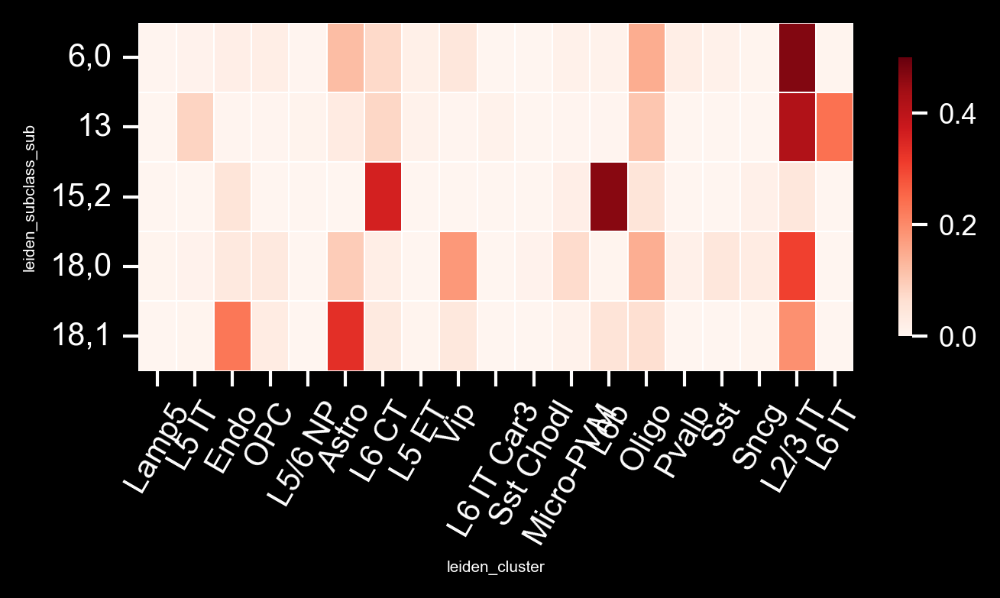

In [82]:
# Plot
fig1=plt.figure(figsize = (5,2), dpi=150)
#sns.set(font_scale=0.25)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted.loc[missed_classes], 
            cmap='Reds', vmin=0, vmax=assign_th, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column, fontsize=5) 
plt.ylabel(fine_query_cluster_column, fontsize=5)
plt.show()

In [83]:
# manual
merged_adata.obs['subclass_manual_label'] = merged_adata.obs['leiden_subclass_sub'].copy()

manual_assign_dict = {'13':'L6 IT', '9': 'L4/5 IT', '15,2': 'L6b', '7':'VLMC'}
first_assign_dict.update(manual_assign_dict)
# find bad
for _subcls in missed_classes:
    if _subcls not in first_assign_dict:
        first_assign_dict[_subcls] = 'Unknown'
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':first_assign_dict})


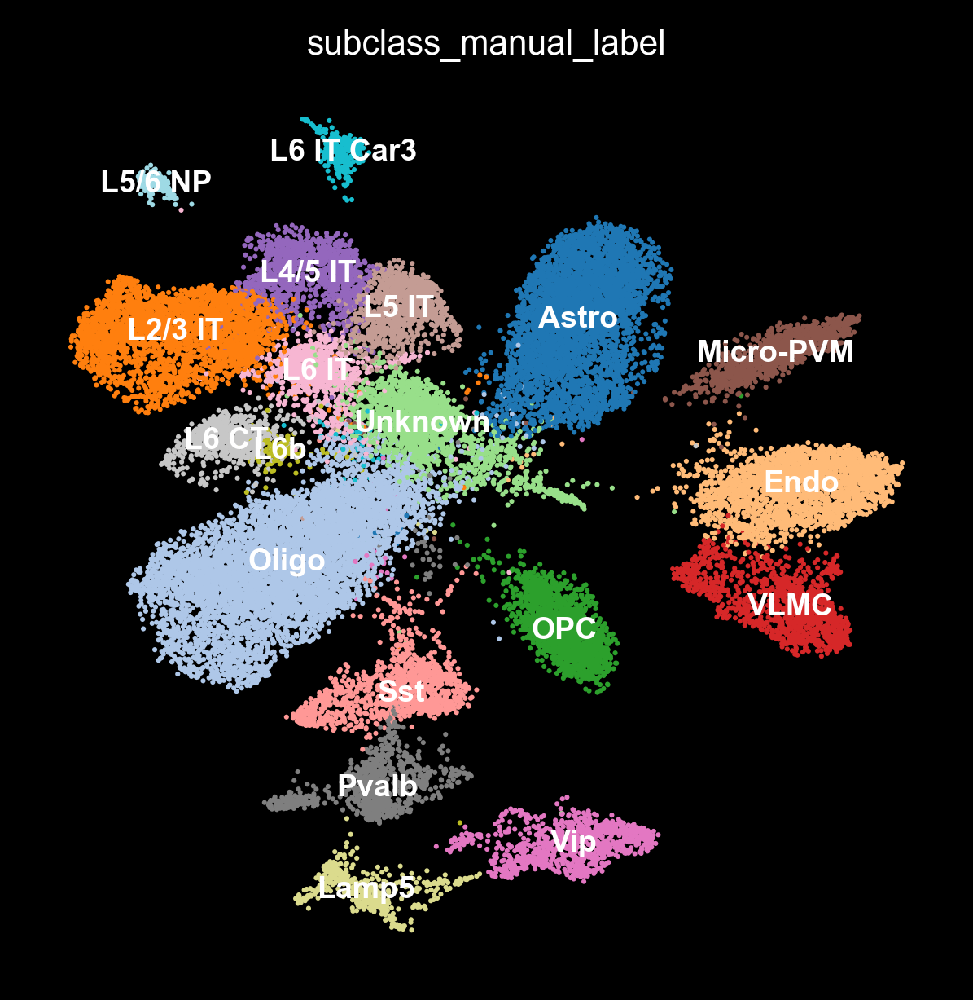

In [196]:
# Plot the predicted sub-subclass
sc.pl.umap(merged_adata, color='subclass_manual_label', legend_loc='on data', 
           palette='tab20', size=6, 
           save='_manual_subclass.png')

In [85]:
types, counts = np.unique(merged_adata.obs['subclass_manual_label'], return_counts=True)
for _type, _count in zip(types, counts):
    print(_type, _count)

Astro 4094
Endo 2429
L2/3 IT 2871
L4/5 IT 1138
L5 IT 988
L5/6 NP 141
L6 CT 672
L6 IT 941
L6 IT Car3 302
L6b 144
Lamp5 469
Micro-PVM 1005
OPC 1608
Oligo 6378
Pvalb 872
Sst 1141
Unknown 1891
VLMC 1230
Vip 954


C:\Users\puzheng_new\AppData\Local\Temp\2\ipykernel_19740\376928024.py:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(types, rotation=45, fontsize=7.5)
C:\Users\puzheng_new\AppData\Local\Temp\2\ipykernel_19740\376928024.py:9: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


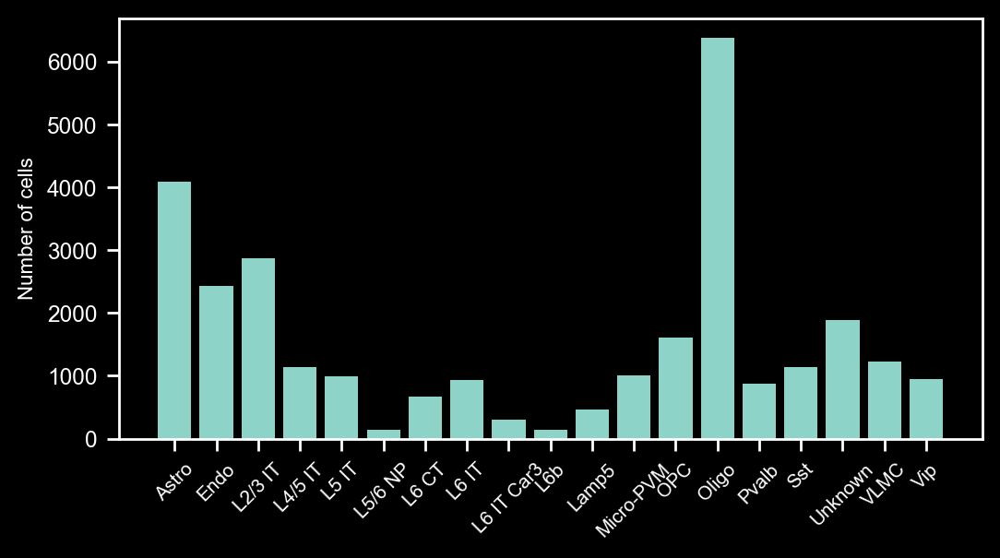

In [175]:
# print class number
fig, ax = plt.subplots(figsize=(6,3), dpi=100)
ax.grid(False)
ax.bar(types, counts)
ax.set_ylabel('Number of cells', fontsize=8)
ax.set_xticklabels(types, rotation=45, fontsize=7.5)
plt.savefig(os.path.join(figure_folder,'cell_count_barplot.png'), transparent=True)

fig.show()

In [87]:
prediction_column = 'pred_subclass'

ref_cluster_column = 'subclass'

# determine which class to query
check_query_cluster_column = 'subclass_manual_label'

## Count predictions
prediction_counts = merged_adata.obs[[check_query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[check_query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')

C:\Users\puzheng_new\AppData\Local\Temp\2\ipykernel_19740\999472041.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


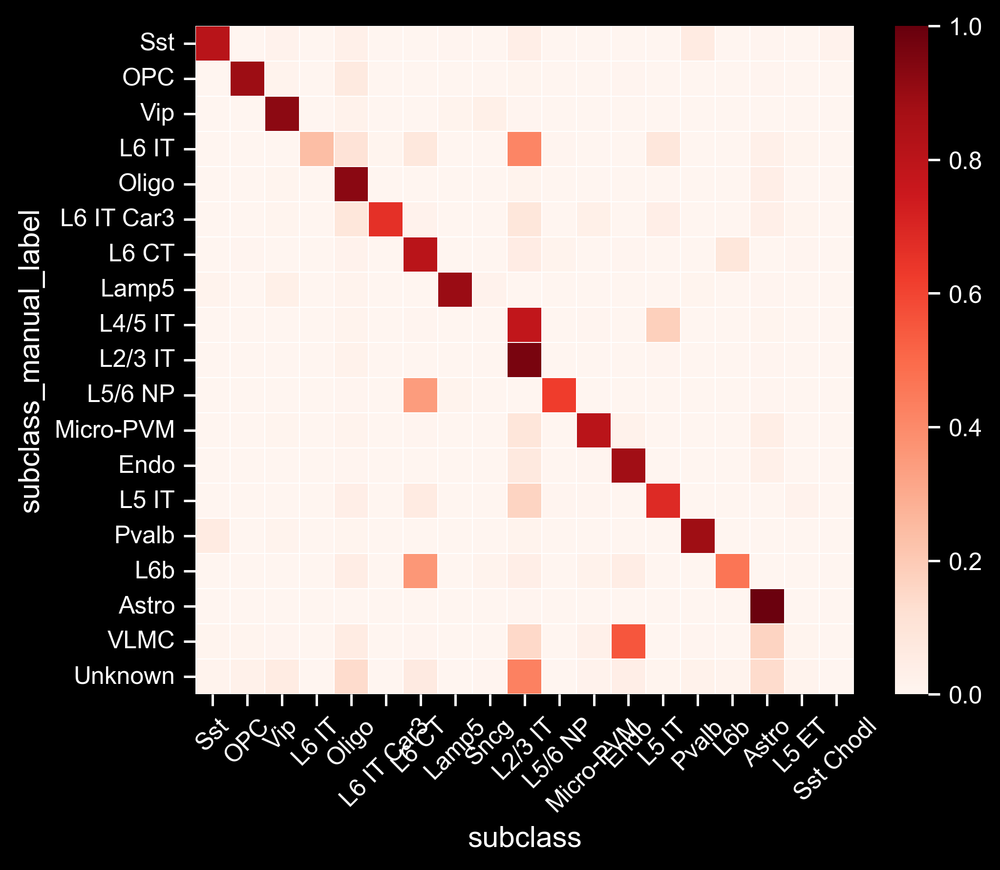

In [176]:
# Plot
fig1=plt.figure(figsize = (6,5))
#sns.set(font_scale=0.2)

ax = sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": 1})
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=10)

plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 45)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column, size=12) 
plt.ylabel(check_query_cluster_column, size=12)
plt.savefig(os.path.join(figure_folder, 'match_predictClass.png'), transparent=True)
plt.show()

# Compare with bulk

In [98]:
bulk_seq_folder = r'\\10.245.74.158\Chromatin_NAS_0\RNA-seq'
bulk_seq_df = pd.read_excel(os.path.join(bulk_seq_folder, 'mmc3.xlsx'), header=1)

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():


In [97]:
bulk_seq_df.columns

Index(['Gene', '69yo surround', '59yo', '65yo', '64yo', '21yo', '22yo',
       '53yo - A', '53yo - B', '18gw - 1', '18gw - 2', '18.5gw - 1', '18.1gw',
       '18.5gw - 2', '18.5gw - 3', '8yo', '13yo', '16yo', '21yo.1', '22yo.1',
       '35yo', '47yo', '51yo', '53yo', '60yo', '63yo - 1', '63yo - 2', '25yo',
       '22yoGC', '63yoGC - 1', '63yo GC - 2', '47yoO4', '63yoO4', '45yo',
       '51yo.1', '63yo', '13yo.1', '47yo.1', '45yo.1', '63yo.1', '25yo.1',
       '53yo.1', 'FACS - p69', 'FACS p70', '1 month', '4 months', '7 months',
       '9 months', 'Neuron 3', 'Neuron 4', 'Oligodendrocyte precursor cell 3',
       'Oligodendrocyte precursor cell 4', 'Newly formed oligodendrocyte 3',
       'Newly formed oligodendrocyte 4', 'Myelinating oligodendrocyte 4',
       'Myelinating oligodenrocyte 5', 'Microglia 1', 'Microglia 2', 'Endo 1',
       'Endo 2', 'whole cortex 1', 'whole cortex 2', 'whole cortex 3'],
      dtype='object')

In [103]:
bulk_seq_df

,Gene,69yo surround,59yo,65yo,64yo,21yo,22yo,53yo - A,53yo - B,18gw - 1,...,Newly formed oligodendrocyte 4,Myelinating oligodendrocyte 4,Myelinating oligodenrocyte 5,Microglia 1,Microglia 2,Endo 1,Endo 2,whole cortex 1,whole cortex 2,whole cortex 3
0,Aamp,0.100000,1.137050,0.737554,1.483750,1.402670,3.405380,2.10816,0.734005,2.775240,...,67.032890,59.552974,58.887146,80.689138,106.531127,51.639999,53.603442,43.616073,40.920164,42.481015
1,Abat,10.986100,17.210100,12.334600,36.963900,16.071600,12.348800,10.19820,9.389870,8.538390,...,51.164416,17.292159,23.631016,2.239617,1.889708,2.408329,1.998207,37.442269,41.335770,34.089669
2,Abca1,2.105060,35.207800,11.200500,27.492500,8.760570,10.072700,6.45330,4.780500,0.869607,...,5.119994,0.105130,0.500564,10.739694,6.235636,50.344032,46.398303,23.411057,21.684440,25.981365
3,Abca2,0.517467,0.625675,0.558765,0.290680,7.656260,0.221189,8.23728,8.466140,1.689110,...,107.227360,141.805749,135.731250,5.784804,7.843130,2.250534,2.132678,14.855843,14.403684,15.068222
4,Abcc5,2.140640,3.199440,2.312600,5.652140,3.743130,5.720110,4.07649,5.113580,2.437010,...,26.760349,10.588956,14.408827,18.228932,13.614145,8.585884,10.326325,25.137654,23.004457,29.834670
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15036,Zxdb,3.665580,5.889190,5.490220,3.401780,2.739110,2.201460,4.58040,4.732810,1.848000,...,2.068197,0.662177,0.950171,2.132732,2.071915,2.761553,2.741752,2.491583,2.548304,2.310357
15037,Zyg11a,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.10000,0.100000,0.100000,...,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000
15038,Zyx,0.421025,14.360200,3.088360,0.813699,0.296565,0.131098,2.07189,0.727896,13.693200,...,13.413930,19.308975,22.301775,73.129074,75.242714,36.201357,34.631930,18.874754,15.679430,12.269224
15039,Zzef1,0.541443,2.083640,1.407010,1.555740,3.017970,1.363860,3.59349,2.861800,4.001980,...,5.354791,1.503722,2.332118,2.710572,2.157235,4.682523,4.205145,6.210297,5.406637,6.128228


In [121]:
cortex_bulk_seq_df = bulk_seq_df[['Gene', '45yo.1', '63yo.1', '25yo.1','53yo.1']]
cortex_bulk_seq_df['mean_counts'] = cortex_bulk_seq_df[['45yo.1', '63yo.1', '25yo.1','53yo.1']].mean(1)

C:\Users\puzheng_new\AppData\Local\Temp\2\ipykernel_19740\3763943116.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cortex_bulk_seq_df['mean_counts'] = cortex_bulk_seq_df[['45yo.1', '63yo.1', '25yo.1','53yo.1']].mean(1)


In [122]:
cortex_bulk_seq_df

,Gene,45yo.1,63yo.1,25yo.1,53yo.1,mean_counts
0,Aamp,1.217970,0.452229,1.206570,1.373200,1.062492
1,Abat,11.627800,6.692170,14.460200,9.663120,10.610822
2,Abca1,1.130400,1.567920,1.724530,1.811450,1.558575
3,Abca2,0.854170,0.100000,0.502650,0.154346,0.402792
4,Abcc5,3.807100,1.749090,5.944640,1.509800,3.252658
...,...,...,...,...,...,...
15036,Zxdb,1.605440,1.201350,1.129020,1.261270,1.299270
15037,Zyg11a,0.100000,0.100000,0.100000,0.100000,0.100000
15038,Zyx,0.383067,0.100000,0.280020,0.100000,0.215772
15039,Zzef1,0.777623,0.273012,0.604469,0.241306,0.474103


In [109]:
gene_list = list(merged_adata.var.index)

In [127]:
merfish_means = []
bulk_means = []
sel_genes = []
for _gene, _mc in zip(cortex_bulk_seq_df['Gene'],cortex_bulk_seq_df['mean_counts']):
    if _gene.upper() in gene_list:
        sel_genes.append(_gene)
        bulk_means.append(_mc)
        # merfish
        merfish_means.append(merged_adata.var['mean_counts'][_gene.upper()])

In [89]:
from scipy import stats
from sklearn.linear_model import LinearRegression

In [145]:
sel_x = np.array(bulk_means)
sel_y = np.array(merfish_means)
reg = LinearRegression().fit(np.log(sel_x[:,np.newaxis]), np.log(sel_y))

In [159]:
rscore = np.sqrt(reg.score(np.log(sel_x[:,np.newaxis]), np.log(sel_y)))

In [197]:
print(figure_folder)

I:\MERFISH_Analysis\hM1_hM1-Cx28_summary_new_segmentation\Figures


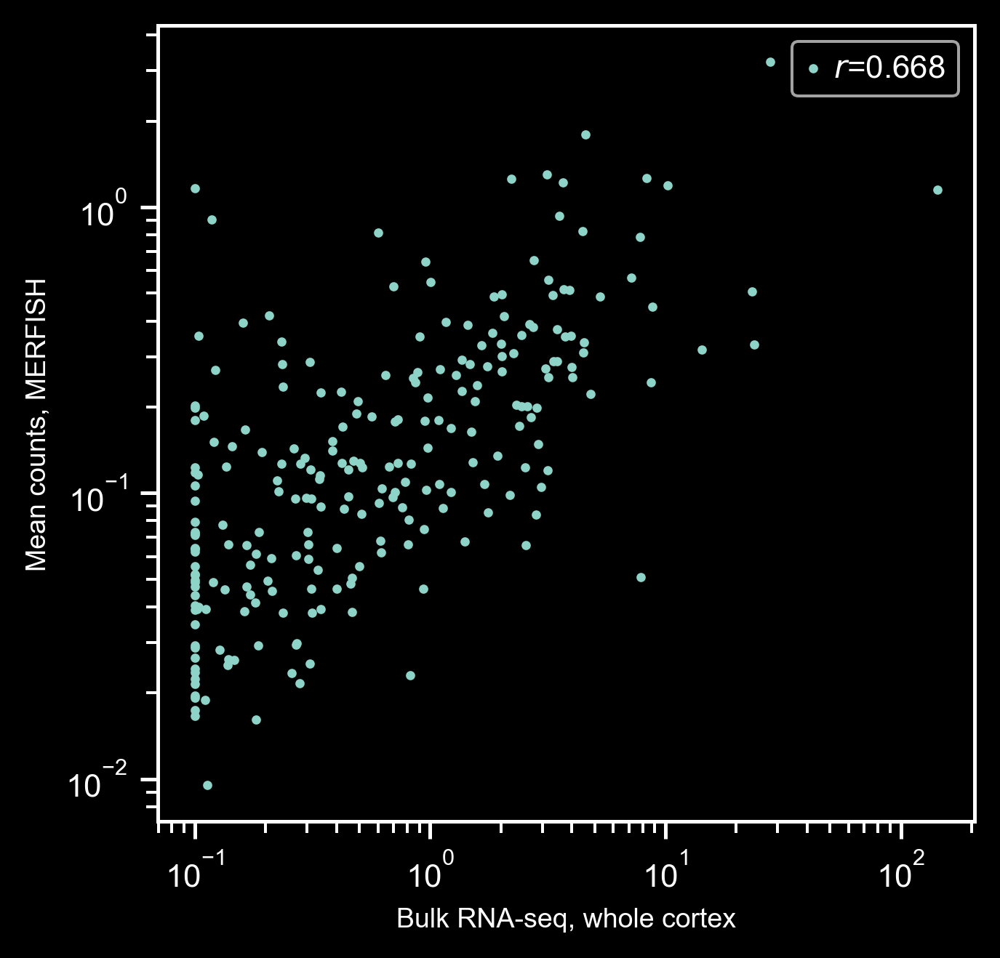

In [174]:
#sel_x = np.log(sel_seq_adata.var['mean_counts'].values)
#sel_y = np.log(merfish_adata.var['mean_counts'][sel_seq_adata.var['mean_counts'].index])
#reg = LinearRegression().fit(sel_x[:,np.newaxis], sel_y)

fig, ax = plt.subplots(figsize=(4,4))
ax.grid(False)
ax.scatter(sel_x, sel_y, s=3, label=f"$r$={rscore:.3f}")
ax.legend()
ax.set_xscale('log')
ax.set_yscale('log')
# labels
ax.set_xlabel('Bulk RNA-seq, whole cortex')
ax.set_ylabel('Mean counts, MERFISH')

plt.savefig(os.path.join(figure_folder,'bulk_meancount_scatter.png'), transparent=True)

plt.show()

In [297]:
excit_sel_seq_adata = sel_seq_adata[sel_seq_adata.obs['class_label'] == 'Glutamatergic']

In [300]:
merged_adata.obs

,fov,volume,center_x,center_y,min_x,max_x,min_y,max_y,experiment,n_genes_by_counts,total_counts,doublet_score,predicted_doublet,leiden,leiden_cluster,pred_subclass,leiden_subclass_sub,subclass_manual_label
Unnamed: 0,,,,,,,,,,,,,,,,,,
103319656978857788533281348781974494768,0,1054.734168,-1945.379949,-3274.001997,-1951.438749,-1939.321148,-3279.898798,-3268.105197,20221023,69,173.0,0.071256,False,14,14,Sst,14,Vip
115834543180254791934027230912958763970,0,894.337713,-1955.207949,-3296.303998,-1960.618749,-1949.797149,-3301.714798,-3290.893198,20221023,28,49.0,0.100491,False,0,0,Astro,0,Oligo
121668042167514516196846342739648740802,0,1330.875766,-1912.331948,-3232.043996,-1919.146748,-1905.517148,-3238.966797,-3225.121196,20221023,24,49.0,0.029916,False,12,12,Micro-PVM,12,Micro-PVM
121875778843599906962036224160790958959,0,866.444305,-1887.761947,-3195.323995,-1893.766747,-1881.757147,-3200.194796,-3190.453195,20221023,43,115.0,0.028284,False,1,1,L2/3 IT,1,L2/3 IT
152279561911339243042976079098299457422,0,160.065897,-1929.719948,-3181.715995,-1933.186748,-1926.253148,-3184.858795,-3178.573195,20221023,22,41.0,0.049745,False,10,10,Sst,10,Sst
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85056392730639477486868398302435488566,395,1141.204420,-5194.403996,688.185973,-5201.326796,-5187.481196,682.343173,694.028773,20221026,23,40.0,0.082407,False,15,15,Astro,15,Pvalb
86905460498622200934338852145108404684,395,1664.819019,-5171.777995,743.049975,-5179.726795,-5163.829195,736.127174,749.972775,20221026,128,644.0,0.102634,False,9,9,L2/3 IT,9,L4/5 IT
8790454268023804631667754211581914097,395,970.948619,-5193.269996,670.473973,-5199.922796,-5186.617196,665.603173,675.344773,20221026,43,110.0,0.049745,False,8,8,VLMC,8,VLMC


In [302]:
excit_subclasses = ['L2/3 IT', 'L4/5 IT', 'L5 IT', 'L5/6 NP', 'L6 CT', 'L6 IT', 'L6 IT Car3', 'L6b',]

In [304]:
merged_excit_mask = np.array([_subcls in excit_subclasses for _subcls in merged_adata.obs['subclass_manual_label']])

In [305]:
excit_merged_adata = merged_adata[merged_excit_mask]

In [307]:
sc.pp.calculate_qc_metrics(excit_merged_adata, percent_top=None, log1p=False, inplace=True)

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\preprocessing\_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


In [308]:
sc.pp.calculate_qc_metrics(excit_sel_seq_adata, percent_top=None, log1p=False, inplace=True)

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\preprocessing\_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


In [311]:
sel_x = np.log(excit_sel_seq_adata.var['mean_counts'].values+1)
sel_y = np.log(excit_merged_adata.var['mean_counts'].values+1)
reg = LinearRegression().fit(sel_x[:,np.newaxis], sel_y)

In [312]:
np.sqrt(reg.score(sel_x[:,np.newaxis], sel_y))

0.5653795891879454

0.5653795891879454


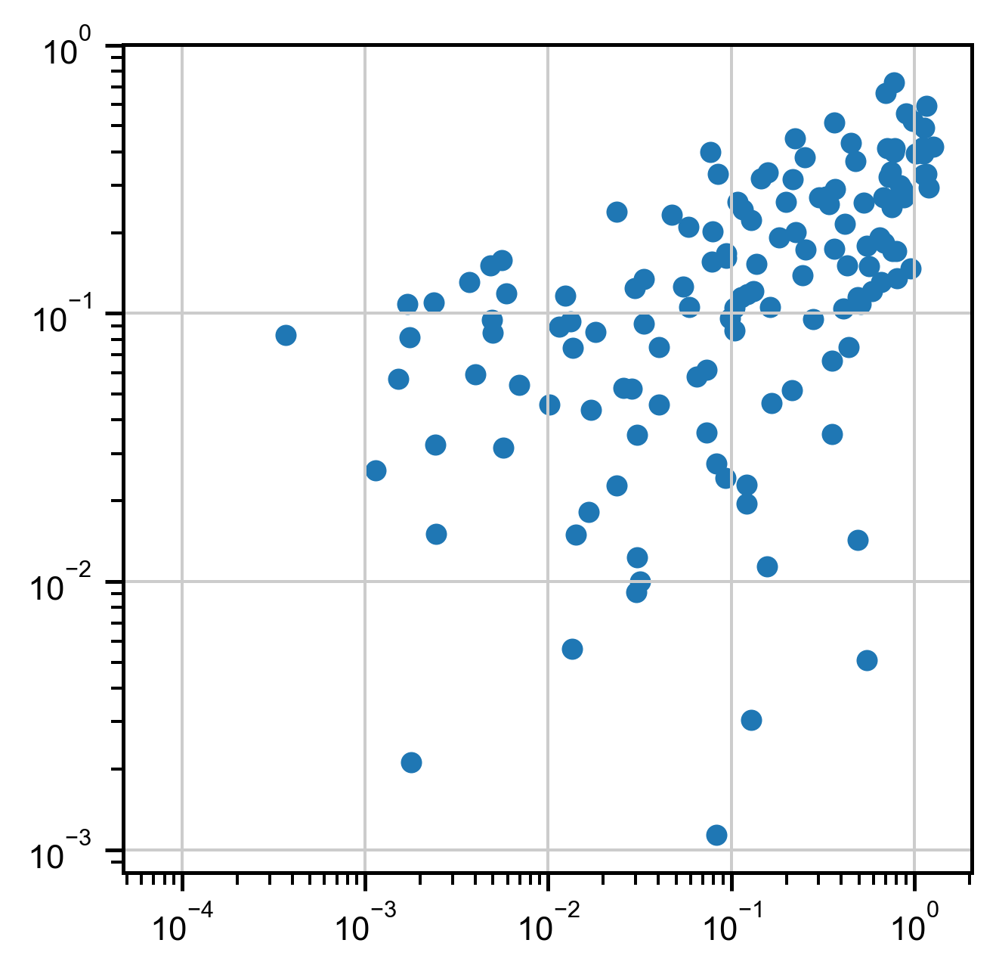

In [314]:

reg = LinearRegression().fit(sel_x[:,np.newaxis], sel_y)
print(np.sqrt(reg.score(sel_x[:,np.newaxis], sel_y)))
plt.figure()
plt.scatter(sel_x, sel_y)
plt.xscale('log')
plt.yscale('log')
plt.show()